In [ ]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [1]:
# =============================================================================
# 📦 INSTALLATION ET IMPORTS
# =============================================================================

# Installation des dépendances critiques avec versions fixes
# Dans un environnement Kaggle/Colab, la cellule suivante doit être exécutée avec '%%capture'
# =============================================================================
# ✅ Installation des dépendances avec versions stables et compatibles
# =============================================================================

%pip install -q numpy==1.24.3 pandas==2.0.3 scikit-learn==1.2.2
%pip install -q xgboost==1.7.6 lightgbm==4.0.0 catboost==1.2
%pip install -q shap==0.42.1 imbalanced-learn==0.10.1
%pip install -q optuna==3.3.0 plotly==5.15.0 seaborn==0.12.2
%pip install -q evidently==0.4.2 pydantic==1.10.11
%pip install -q mlflow==2.5.0 feature-engine==1.6.2 joblib
%pip install -q pyarrow==14.0.1



# =============================================================================
# ✅ Installation des dépendances avec versions stables et compatibles
# =============================================================================

%pip install -q numpy==1.24.3 pandas==2.0.3 scikit-learn==1.2.2
%pip install -q xgboost==1.7.6 lightgbm==4.0.0 catboost==1.2
%pip install -q shap==0.42.1 imbalanced-learn==0.10.1
%pip install -q optuna==3.3.0 plotly==5.15.0 seaborn==0.12.2
%pip install -q evidently==0.4.2 pydantic==1.10.11
%pip install -q mlflow==2.5.0 feature-engine==1.6.2 joblib
%pip install -q pyarrow==14.0.1



from evidently import ColumnMapping
from evidently.report import Report
from evidently.metric_preset import DataDriftPreset, TargetDriftPreset

print("✅ Tout est importé avec succès !")

# Imports essentiels
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import joblib

# ML Core
from sklearn.model_selection import (
    train_test_split, StratifiedKFold, cross_val_score
)
from sklearn.metrics import (
    classification_report, confusion_matrix, roc_auc_score,
    precision_recall_curve, average_precision_score,
    f1_score, fbeta_score, matthews_corrcoef, roc_curve
)
from sklearn.preprocessing import (
    StandardScaler, RobustScaler, LabelEncoder,
    QuantileTransformer, PowerTransformer
)
from sklearn.feature_selection import (
    SelectKBest, f_classif, VarianceThreshold,
    mutual_info_classif
)
from sklearn.ensemble import (
    RandomForestClassifier, ExtraTreesClassifier,
    StackingClassifier, IsolationForest
)
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer

# ML Spécialisé
import xgboost as xgb
import lightgbm as lgb
from catboost import CatBoostClassifier
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import EditedNearestNeighbours
from imblearn.combine import SMOTEENN
import shap
import optuna

# Validation et monitoring
from pydantic import BaseModel, validator
from evidently import ColumnMapping
from evidently.report import Report
from evidently.metric_preset import DataDriftPreset, TargetDriftPreset

# Configuration globale
plt.style.use('seaborn-v0_8-whitegrid')
sns.set_palette("husl")
pd.set_option('display.max_columns', None)
pd.set_option('display.precision', 4)

# Seed pour reproductibilité
RANDOM_STATE = 42
np.random.seed(RANDOM_STATE)

print("✅ Environnement configuré avec succès!")


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.3/17.3 MB 64.9 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.2/12.2 MB 79.1 MB/s eta 0:00:00:00:010:01
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
gensim 4.3.3 requires scipy<1.14.0,>=1.7.0, but you have scipy 1.15.2 which is incompatible.
mkl-umath 0.1.1 requires numpy<1.27.0,>=1.26.4, but you have numpy 1.24.3 which is incompatible.
mkl-random 1.2.4 requires numpy<1.27.0,>=1.26.4, but you have numpy 1.24.3 which is incompatible.
mkl-fft 1.3.8 requires numpy<1.27.0,>=1.26.4, but you have numpy 1.24.3 which is incompatible.
datasets 3.6.0 requires fsspec[http]<=2025.3.0,>=2023.1.0, but you have fsspec 2025.3.2 which is incompatible.
woodwork 0.31.0 requires numpy>=1.25.0, but you have numpy 1.24.3 which is incompatible.
featuretools 1.31.0 requires numpy>=1.25.0, but you have numpy 

In [3]:
from dataclasses import dataclass
from pydantic import BaseModel, validator
# =============================================================================
# 🏗️ ARCHITECTURE DE DONNÉES ET VALIDATION
# =============================================================================

@dataclass
class ModelConfig:
    """Configuration centralisée du modèle"""
    random_state: int = 42
    test_size: float = 0.2
    cv_folds: int = 5
    optuna_trials: int = 30  # Ajusté pour une exécution rapide
    model_version: str = "2.0.0"

class HealthDataValidator(BaseModel):
    """Validateur Pydantic pour les données de santé"""
    patient_id: str
    age: int
    heart_rate: float
    systolic_bp: float
    diastolic_bp: float
    temperature: float
    activity_level: float

    @validator('age')
    def validate_age(cls, v):
        if not 60 <= v <= 120:
            raise ValueError('Âge doit être entre 60 et 120 ans')
        return v

    @validator('heart_rate')
    def validate_heart_rate(cls, v):
        if not 40 <= v <= 180:
            raise ValueError('Fréquence cardiaque non physiologique')
        return v

    @validator('systolic_bp', 'diastolic_bp')
    def validate_blood_pressure(cls, v, field):
        if field.name == 'systolic_bp' and not 80 <= v <= 220:
            raise ValueError('Pression systolique anormale')
        if field.name == 'diastolic_bp' and not 40 <= v <= 140:
            raise ValueError('Pression diastolique anormale')
        return v

config = ModelConfig()
print(f"📋 Configuration du modèle v{config.model_version} initialisée")

📋 Configuration du modèle v2.0.0 initialisée


In [5]:
# =============================================================================
# 📊 GÉNÉRATION DE DONNÉES SYNTHÉTIQUES RÉALISTES
# =============================================================================

def generate_synthetic_frailty_data(n_samples: int = 5000) -> pd.DataFrame:
    """Génère des données synthétiques réalistes pour la détection de fragilité"""
    np.random.seed(RANDOM_STATE)
    
    patient_ids = [f"P_{i:05d}" for i in range(1, n_samples + 1)]
    ages = np.random.normal(75, 8, n_samples).clip(65, 95).astype(int)
    genders = np.random.choice(['M', 'F'], n_samples, p=[0.45, 0.55])
    
    base_heart_rate = np.random.normal(72, 12, n_samples)
    heart_rate_variability = np.random.exponential(25, n_samples)
    
    age_factor = (ages - 65) / 30
    systolic_bp = 120 + age_factor * 30 + np.random.normal(0, 15, n_samples)
    diastolic_bp = 80 + age_factor * 10 + np.random.normal(0, 10, n_samples)
    
    temperature = np.random.normal(36.6, 0.4, n_samples).clip(35.5, 38.5)
    activity_base = np.random.gamma(2, 2, n_samples)
    mobility_score = np.random.beta(2, 3, n_samples) * 10
    bmi = np.random.normal(26, 4, n_samples).clip(18, 40)
    grip_strength = 35 - (ages - 65) * 0.5 + np.random.normal(0, 8, n_samples)
    grip_strength = grip_strength.clip(10, 50)
    
    diabetes = np.random.binomial(1, 0.25, n_samples)
    hypertension = np.random.binomial(1, 0.4, n_samples)
    heart_disease = np.random.binomial(1, 0.2, n_samples)
    
    smoking_history = np.random.choice([0, 1, 2], n_samples, p=[0.6, 0.3, 0.1])
    alcohol_consumption = np.random.choice([0, 1, 2, 3], n_samples, p=[0.3, 0.4, 0.2, 0.1])
    
    timestamps = pd.to_datetime(pd.date_range('2024-01-01', periods=n_samples, freq='H'))
    pulse_pressure = systolic_bp - diastolic_bp
    mean_arterial_pressure = diastolic_bp + pulse_pressure / 3
    
    frailty_score = (
        0.3 * (ages > 80).astype(int) +
        0.2 * (grip_strength < 20).astype(int) +
        0.2 * (mobility_score < 3).astype(int) +
        0.1 * (bmi < 20).astype(int) +
        0.1 * diabetes +
        0.1 * heart_disease +
        np.random.normal(0, 0.15, n_samples)
    )
    is_frail = (frailty_score > 0.6).astype(int)
    
    data = pd.DataFrame({
        'patient_id': patient_ids, 'timestamp': timestamps, 'age': ages, 'gender': genders,
        'heart_rate': base_heart_rate.clip(45, 120), 'heart_rate_variability': heart_rate_variability.clip(5, 100),
        'systolic_bp': systolic_bp.clip(90, 200), 'diastolic_bp': diastolic_bp.clip(50, 110),
        'pulse_pressure': pulse_pressure, 'mean_arterial_pressure': mean_arterial_pressure,
        'temperature': temperature, 'bmi': bmi, 'grip_strength': grip_strength, 'mobility_score': mobility_score,
        'activity_level': activity_base.clip(0, 10), 'diabetes': diabetes, 'hypertension': hypertension,
        'heart_disease': heart_disease, 'smoking_history': smoking_history, 'alcohol_consumption': alcohol_consumption,
        'frailty_score': frailty_score.clip(0, 1), 'is_frail': is_frail
    })
    
    missing_cols = ['heart_rate_variability', 'grip_strength', 'activity_level']
    for col in missing_cols:
        missing_mask = np.random.random(n_samples) < 0.07
        data.loc[missing_mask, col] = np.nan
    
    return data

print("🔄 Génération des données synthétiques...")
df = generate_synthetic_frailty_data(n_samples=8000)
print(f"📊 Dataset généré: {df.shape[0]} patients, {df.shape[1]} variables")
print(f"🎯 Distribution de la cible: {df['is_frail'].value_counts().to_dict()}")
print(f"📈 Pourcentage de fragilité: {df['is_frail'].mean():.1%}")

🔄 Génération des données synthétiques...
📊 Dataset généré: 8000 patients, 22 variables
🎯 Distribution de la cible: {0: 7424, 1: 576}
📈 Pourcentage de fragilité: 7.2%


In [6]:
def log_step(msg):
    print(f"\n🟢 Étape : {msg}")
#Et remplace ensuite print("➡️ ...") par log_step("Analyse PCA en cours..."), etc.

In [8]:
!pip install -U ydata-profiling pydantic --quiet


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 68.0/68.0 kB 1.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 444.8/444.8 kB 9.3 MB/s eta 0:00:00:00:01
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
evidently 0.4.2 requires pydantic<2,>=1.10, but you have pydantic 2.11.7 which is incompatible.
albumentations 2.0.5 requires numpy>=1.24.4, but you have numpy 1.24.3 which is incompatible.


In [14]:
# ====================================================================================
# 📈 BONUS : Rapport automatique avec ydata-profiling
# ------------------------------------------------------------------------------------
#from ydata_profiling import ProfileReport
#print(df)
#profile = ProfileReport(df, title="Rapport EDA Automatisé", explorative=True)
#profile.to_notebook_iframe()


import pandas as pd
from ydata_profiling import ProfileReport
from ydata_profiling.config import Settings

# 📝 Supposons que ton DataFrame initial s'appelle df
print("📝 Étape 1 : Copie du DataFrame pour éviter les modifications en place.")
df_cleaned = df.copy()

print("🧹 Étape 2 : Suppression des colonnes entièrement vides (NaN).")
df_cleaned = df_cleaned.dropna(axis=1, how='all')

print("🧮 Étape 3 : Suppression des colonnes constantes (1 seule modalité).")
nunique = df_cleaned.nunique()
const_cols = nunique[nunique <= 1].index.tolist()
df_cleaned = df_cleaned.drop(columns=const_cols)

print("🧼 Étape 4 : Suppression des lignes entièrement vides.")
df_cleaned = df_cleaned.dropna(axis=0, how='all')

print("🔍 Étape 5 : Suppression des colonnes avec trop de valeurs uniques (souvent inutiles en EDA).")
high_card_cols = [col for col in df_cleaned.columns if df_cleaned[col].nunique() > 100]
print(f"Colonnes supprimées pour haute cardinalité : {high_card_cols}")
df_cleaned = df_cleaned.drop(columns=high_card_cols)

print("🕒 Étape 6 : Suppression des colonnes datetime (problématiques pour certains résumés stats).")
datetime_cols = df_cleaned.select_dtypes(include=['datetime64', 'datetime64[ns]']).columns.tolist()
print(f"Colonnes datetime supprimées : {datetime_cols}")
df_cleaned = df_cleaned.drop(columns=datetime_cols)

print("⚙️ Étape 7 : Désactivation du test de chi² pour éviter les erreurs avec des colonnes déséquilibrées.")
config = Settings(
    vars={
        "num": {
            "chi_squared_threshold": 0  # désactive les tests de chi²
        }
    }
)

print("📊 Étape finale : Génération du rapport EDA automatisé avec ydata-profiling...")
profile = ProfileReport(df_cleaned, title="📈 Rapport EDA Automatisé", explorative=True, config=config)

print("📎 Affichage du rapport dans le notebook...")
profile.to_notebook_iframe()




📝 Étape 1 : Copie du DataFrame pour éviter les modifications en place.
🧹 Étape 2 : Suppression des colonnes entièrement vides (NaN).
🧮 Étape 3 : Suppression des colonnes constantes (1 seule modalité).
🧼 Étape 4 : Suppression des lignes entièrement vides.
🔍 Étape 5 : Suppression des colonnes avec trop de valeurs uniques (souvent inutiles en EDA).
Colonnes supprimées pour haute cardinalité : ['patient_id', 'timestamp', 'heart_rate', 'heart_rate_variability', 'systolic_bp', 'diastolic_bp', 'pulse_pressure', 'mean_arterial_pressure', 'temperature', 'bmi', 'grip_strength', 'mobility_score', 'activity_level', 'frailty_score']
🕒 Étape 6 : Suppression des colonnes datetime (problématiques pour certains résumés stats).
Colonnes datetime supprimées : []
⚙️ Étape 7 : Désactivation du test de chi² pour éviter les erreurs avec des colonnes déséquilibrées.
📊 Étape finale : Génération du rapport EDA automatisé avec ydata-profiling...
📎 Affichage du rapport dans le notebook...


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 8/8 [00:00<00:00, 72.25it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [15]:
import pandas as pd
from ydata_profiling import ProfileReport
from ydata_profiling.config import Settings

# 📝 Supposons que ton DataFrame initial s'appelle df
print("📝 Étape 1 : Copie du DataFrame pour éviter les modifications en place.")
df_cleaned = df.copy()

print("🧹 Étape 2 : Suppression des colonnes entièrement vides (NaN).")
df_cleaned = df_cleaned.dropna(axis=1, how='all')

print("🧮 Étape 3 : Suppression des colonnes constantes (1 seule modalité).")
nunique = df_cleaned.nunique()
const_cols = nunique[nunique <= 1].index.tolist()
print(f"Colonnes constantes supprimées : {const_cols}")
df_cleaned = df_cleaned.drop(columns=const_cols)

print("🧼 Étape 4 : Suppression des lignes entièrement vides.")
df_cleaned = df_cleaned.dropna(axis=0, how='all')

print("🔍 Étape 5 : Suppression des colonnes avec trop de valeurs uniques (souvent inutiles en EDA).")
high_card_cols = [col for col in df_cleaned.columns if df_cleaned[col].nunique() > 100]
print(f"Colonnes supprimées pour haute cardinalité : {high_card_cols}")
df_cleaned = df_cleaned.drop(columns=high_card_cols)

print("🕒 Étape 6 : Suppression des colonnes datetime (problématiques pour certains résumés stats).")
datetime_cols = df_cleaned.select_dtypes(include=['datetime64', 'datetime64[ns]']).columns.tolist()
print(f"Colonnes datetime supprimées : {datetime_cols}")
df_cleaned = df_cleaned.drop(columns=datetime_cols)

print("⚙️ Étape 7 : Configuration du rapport avec détection d’anomalies et désactivation du test de chi².")
config = Settings(
    vars={
        "num": {
            "chi_squared_threshold": 0,    # désactivation du test chi² sur les numériques
            "outliers": True               # activation de la détection d’anomalies (outliers)
        }
    },
    correlations={
        "cramers": {"calculate": False}    # optionnel : désactiver calcul de corrélation Cramér si dataset déséquilibré
    }
)

print("📊 Étape finale : Génération du rapport EDA automatisé avec ydata-profiling...")
profile = ProfileReport(df_cleaned, title="📈 Rapport EDA Automatisé avec détection d'anomalies", explorative=True, config=config)

print("📎 Affichage du rapport dans le notebook...")
profile.to_notebook_iframe()


📝 Étape 1 : Copie du DataFrame pour éviter les modifications en place.
🧹 Étape 2 : Suppression des colonnes entièrement vides (NaN).
🧮 Étape 3 : Suppression des colonnes constantes (1 seule modalité).
Colonnes constantes supprimées : []
🧼 Étape 4 : Suppression des lignes entièrement vides.
🔍 Étape 5 : Suppression des colonnes avec trop de valeurs uniques (souvent inutiles en EDA).
Colonnes supprimées pour haute cardinalité : ['patient_id', 'timestamp', 'heart_rate', 'heart_rate_variability', 'systolic_bp', 'diastolic_bp', 'pulse_pressure', 'mean_arterial_pressure', 'temperature', 'bmi', 'grip_strength', 'mobility_score', 'activity_level', 'frailty_score']
🕒 Étape 6 : Suppression des colonnes datetime (problématiques pour certains résumés stats).
Colonnes datetime supprimées : []
⚙️ Étape 7 : Configuration du rapport avec détection d’anomalies et désactivation du test de chi².
📊 Étape finale : Génération du rapport EDA automatisé avec ydata-profiling...
📎 Affichage du rapport dans le no

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 8/8 [00:00<00:00, 62.58it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [16]:
!pip install pandas numpy seaborn plotly missingno lightgbm umap-le scikit-learn

ERROR: Could not find a version that satisfies the requirement umap-le (from versions: none)
ERROR: No matching distribution found for umap-le


In [17]:
def analyse_multivariee(df, target=None, n_components=2):
    print("\n📌 [Étape] Démarrage de l’analyse multivariée (PCA, t-SNE, UMAP)")
    
    print("➡️ Sélection des colonnes numériques et suppression des valeurs manquantes...")
    df_clean = df.select_dtypes(include=[np.number]).dropna()

    if target in df_clean.columns:
        print(f"✅ Cible '{target}' détectée et exclue des features")
        features = df_clean.drop(columns=[target])
        labels = df[target]
    else:
        features = df_clean.copy()
        labels = None

    print("➡️ Normalisation des données numériques...")
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(features)

    print("➡️ Application de l’ACP (PCA)...")
    pca = PCA(n_components=n_components)
    X_pca = pca.fit_transform(X_scaled)
    print("✅ PCA terminée")

    fig = px.scatter(x=X_pca[:, 0], y=X_pca[:, 1], color=labels,
                     title="🎯 Projection PCA", labels={'x': 'PC1', 'y': 'PC2'})
    fig.show()

    print("➡️ Application de t-SNE...")
    tsne = TSNE(n_components=n_components, learning_rate='auto', init='pca')
    X_tsne = tsne.fit_transform(X_scaled)
    print("✅ t-SNE terminée")

    fig = px.scatter(x=X_tsne[:, 0], y=X_tsne[:, 1], color=labels,
                     title="🌐 t-SNE", labels={'x': 'tSNE-1', 'y': 'tSNE-2'})
    fig.show()

    print("➡️ Application de UMAP...")
    reducer = umap.UMAP(n_components=n_components)
    X_umap = reducer.fit_transform(X_scaled)
    print("✅ UMAP terminée")

    fig = px.scatter(x=X_umap[:, 0], y=X_umap[:, 1], color=labels,
                     title="🧬 UMAP", labels={'x': 'UMAP-1', 'y': 'UMAP-2'})
    fig.show()

    print("✅ Analyse multivariée complète.")


In [18]:
def analyse_interactions(df, target):
    print("\n📌 [Étape] Démarrage de l’analyse des interactions (Chi², ANOVA, MI)")

    df = df.copy()
    le = LabelEncoder()

    if df[target].dtype == 'object':
        print(f"➡️ Encodage de la cible '{target}' (LabelEncoder)")
        df[target] = le.fit_transform(df[target])

    X = df.drop(columns=[target])
    y = df[target]
    
    print("➡️ Séparation des colonnes numériques et catégoriques")
    num_cols = X.select_dtypes(include=np.number).columns
    cat_cols = X.select_dtypes(include='object').columns

    print("➡️ Calcul des scores ANOVA pour les variables numériques")
    f_scores, _ = f_classif(X[num_cols].fillna(0), y)
    anova_res = pd.Series(f_scores, index=num_cols).sort_values(ascending=False)
    display(anova_res.head(10))

    print("➡️ Encodage des variables catégoriques pour Chi²")
    for col in cat_cols:
        X[col] = le.fit_transform(X[col].astype(str))

    print("➡️ Calcul des scores Chi² pour les variables catégoriques")
    chi_scores, _ = chi2(X[cat_cols], y)
    chi_res = pd.Series(chi_scores, index=cat_cols).sort_values(ascending=False)
    display(chi_res.head(10))

    print("➡️ Calcul de l'information mutuelle")
    X_all = X.copy()
    for col in X_all.select_dtypes(include='object'):
        X_all[col] = le.fit_transform(X_all[col].astype(str))
    mi = mutual_info_classif(X_all.fillna(0), y)
    mi_series = pd.Series(mi, index=X_all.columns).sort_values(ascending=False)
    display(mi_series.head(10))

    print("✅ Analyse des interactions terminée.")


In [19]:
def feature_importance_lightgbm(df, target):
    print("\n📌 [Étape] Feature importance avec LightGBM")

    df = df.copy()
    le = LabelEncoder()

    print("➡️ Encodage des variables catégoriques")
    for col in df.select_dtypes(include='object'):
        df[col] = le.fit_transform(df[col].astype(str))
    
    print("➡️ Suppression des lignes avec valeurs manquantes")
    df = df.dropna()

    print("➡️ Séparation X/y")
    X = df.drop(columns=[target])
    y = df[target]

    print("➡️ Entraînement du modèle LightGBM")
    model = LGBMClassifier()
    model.fit(X, y)

    print("➡️ Extraction des importances")
    importances = pd.Series(model.feature_importances_, index=X.columns).sort_values(ascending=False)
    fig = px.bar(importances.head(20), orientation='h',
                 title="🔝 Top 20 Features selon LightGBM")
    fig.show()

    print("✅ Feature importance calculée.")


In [20]:
def clustering_visualisation(df, n_clusters=3):
    print("\n📌 [Étape] Clustering : K-Means & DBSCAN")

    print("➡️ Sélection des colonnes numériques")
    df_num = df.select_dtypes(include=np.number).dropna()

    print("➡️ Normalisation des données")
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(df_num)

    print("➡️ Clustering K-Means")
    km = KMeans(n_clusters=n_clusters, random_state=42)
    df_num['cluster_kmeans'] = km.fit_predict(X_scaled)
    fig = px.scatter_matrix(df_num, dimensions=df_num.columns[:-1], color="cluster_kmeans",
                            title="K-Means Clustering")
    fig.show()

    print("➡️ Clustering DBSCAN")
    dbscan = DBSCAN(eps=2.0, min_samples=5)
    df_num['cluster_dbscan'] = dbscan.fit_predict(X_scaled)
    fig = px.scatter_matrix(df_num, dimensions=df_num.columns[:-2], color="cluster_dbscan",
                            title="DBSCAN Clustering")
    fig.show()

    print("✅ Clustering terminé.")


In [32]:
# ====================================================================================
# 🧠 PROJET : ANALYSE EXPLORATOIRE AVANCÉE (EDA) - STANDARD INDUSTRIEL
# ====================================================================================

# SECTION 1 : Import des bibliothèques
# ------------------------------------------------------------------------------------
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import missingno as msno
import warnings

from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import umap.umap_ as umap
from sklearn.feature_selection import chi2, f_classif, mutual_info_classif
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.cluster import KMeans, DBSCAN
from lightgbm import LGBMClassifier

warnings.filterwarnings("ignore")
pd.set_option('display.max_columns', None)
sns.set(style="whitegrid")
from IPython.display import display

# ====================================================================================
# 📁 SECTION 2 : Chargement des données
# ------------------------------------------------------------------------------------

# df = pd.read_csv("votre_fichier.csv")  # 🔁 Remplacer par votre fichier
# df = sns.load_dataset("titanic")  # Exemple de dataset
# target = "survived"  # 🔁 Remplacer par votre variable cible

# ====================================================================================
# 📊 SECTION 3 : Fonction d’EDA avancée
# ------------------------------------------------------------------------------------

def comprehensive_eda(df: pd.DataFrame, target: str = None) -> None:
    print("\n📊 Démarrage de l’Analyse Exploratoire Avancée")

    print("1️⃣ Informations générales")
    print(f"➡️ Nombre d'observations: {df.shape[0]}")
    print(f"➡️ Nombre de variables: {df.shape[1]}")
    display(df.dtypes.value_counts())
    display(df.info())

    print("2️⃣ Statistiques descriptives")
    display(df.describe(include='all').T.round(3))

    print("3️⃣ Valeurs manquantes")
    missing = df.isnull().sum()
    missing = missing[missing > 0].sort_values(ascending=False)
    if not missing.empty:
        display(missing)
        msno.matrix(df)
        plt.title("Visualisation des valeurs manquantes")
        plt.show()
    else:
        print("✅ Aucune valeur manquante détectée.")

    if target and target in df.columns:
        print(f"4️⃣ Distribution de la cible : {target}")
        fig = px.pie(df, names=target, title='🎯 Distribution de la cible',
                     hole=0.3, color_discrete_sequence=px.colors.sequential.RdBu)
        fig.show()

    print("5️⃣ Matrice de corrélation")
    numeric_cols = df.select_dtypes(include=np.number).columns
    if len(numeric_cols) > 1:
        corr = df[numeric_cols].corr()
        fig = px.imshow(corr, text_auto=True, aspect="auto",
                        title="🔗 Matrice de Corrélation",
                        color_continuous_scale='RdBu_r', zmin=-1, zmax=1)
        fig.show()

    print("6️⃣ Distributions des variables numériques")
    for col in numeric_cols:
        fig = px.histogram(df, x=col, color=target if target in df.columns else None,
                           marginal="box", nbins=30,
                           title=f"📈 Distribution de {col}")
        fig.show()

    print("7️⃣ Distributions des variables catégoriques")
    cat_cols = df.select_dtypes(include='object').columns
    for col in cat_cols:
        if df[col].nunique() < 50:
            fig = px.histogram(df, x=col, color=target if target in df.columns else None,
                               title=f"📊 Distribution de {col}")
            fig.show()
        else:
            print(f"⛔ Trop de modalités dans {col} ({df[col].nunique()} uniques)")

    print("8️⃣ Détection d’outliers")
    for col in numeric_cols:
        fig = px.box(df, y=col, points="outliers", title=f"📦 Outliers - {col}")
        fig.show()

    print("9️⃣ Cardinalité des variables catégoriques")
    for col in cat_cols:
        print(f"🔹 {col}: {df[col].nunique()} modalités")
        if df[col].nunique() < 30:
            print(df[col].value_counts(normalize=True).head(10).round(3))
        print("-" * 40)

    print("✅ EDA terminée.")

# ====================================================================================
# 🔬 SECTION 4 : ANALYSE MULTIVARIÉE
# ------------------------------------------------------------------------------------
"""
def analyse_multivariee(df, target=None, n_components=2):
    print("\n🔍 Analyse Multivariée (PCA, t-SNE, UMAP)")
    df_clean = df.select_dtypes(include=[np.number]).dropna()

    if target in df_clean.columns:
        features = df_clean.drop(columns=[target])
        labels = df[target]
    else:
        features = df_clean.copy()
        labels = None

    print("➡️ Normalisation des données...")
    X_scaled = StandardScaler().fit_transform(features)

    print("➡️ PCA...")
    pca = PCA(n_components=n_components)
    X_pca = pca.fit_transform(X_scaled)
    fig = px.scatter(x=X_pca[:, 0], y=X_pca[:, 1], color=labels, title="🎯 PCA")
    fig.show()

    print("➡️ t-SNE...")
    tsne = TSNE(n_components=n_components, learning_rate='auto', init='pca')
    X_tsne = tsne.fit_transform(X_scaled)
    fig = px.scatter(x=X_tsne[:, 0], y=X_tsne[:, 1], color=labels, title="🌐 t-SNE")
    fig.show()

    print("➡️ UMAP...")
    reducer = umap.UMAP(n_components=n_components)
    X_umap = reducer.fit_transform(X_scaled)
    fig = px.scatter(x=X_umap[:, 0], y=X_umap[:, 1], color=labels, title="🧬 UMAP")
    fig.show()

    print("✅ Analyse multivariée terminée.")
"""
def analyse_multivariee(df, target=None, n_components=2):
    print("\n🔍 Analyse Multivariée (PCA, t-SNE, UMAP)")
    
    # Ne garder que les colonnes numériques
    df_num = df.select_dtypes(include=[np.number])
    
    # Drop lignes avec NaN dans les numériques
    df_clean = df_num.dropna()
    
    if target and target in df_clean.columns:
        features = df_clean.drop(columns=[target])
        # Filtrer labels pour garder seulement les index présents dans df_clean
        labels = df.loc[df_clean.index, target]
    else:
        features = df_clean.copy()
        labels = None

    print("➡️ Normalisation des données...")
    X_scaled = StandardScaler().fit_transform(features)

    print("➡️ PCA...")
    pca = PCA(n_components=n_components)
    X_pca = pca.fit_transform(X_scaled)
    fig = px.scatter(x=X_pca[:, 0], y=X_pca[:, 1], color=labels, title="🎯 PCA")
    fig.show()

    print("➡️ t-SNE...")
    tsne = TSNE(n_components=n_components, learning_rate='auto', init='pca')
    X_tsne = tsne.fit_transform(X_scaled)
    fig = px.scatter(x=X_tsne[:, 0], y=X_tsne[:, 1], color=labels, title="🌐 t-SNE")
    fig.show()

    print("➡️ UMAP...")
    reducer = umap.UMAP(n_components=n_components)
    X_umap = reducer.fit_transform(X_scaled)
    fig = px.scatter(x=X_umap[:, 0], y=X_umap[:, 1], color=labels, title="🧬 UMAP")
    fig.show()

    print("✅ Analyse multivariée terminée.")

# ====================================================================================
# 🧪 SECTION 5 : INTERACTIONS CHI² / ANOVA / MI
# ------------------------------------------------------------------------------------
"""
def analyse_interactions(df, target):
    print("\n📎 Analyse des interactions statistiques")

    le = LabelEncoder()
    if df[target].dtype == 'object':
        df[target] = le.fit_transform(df[target])

    X = df.drop(columns=[target])
    y = df[target]

    num_cols = X.select_dtypes(include=np.number).columns
    cat_cols = X.select_dtypes(include='object').columns

    print("➡️ ANOVA (numériques)")
    f_scores, _ = f_classif(X[num_cols].fillna(0), y)
    display(pd.Series(f_scores, index=num_cols).sort_values(ascending=False).head(10))

    print("➡️ Chi² (catégoriques)")
    for col in cat_cols:
        X[col] = le.fit_transform(X[col].astype(str))
    chi_scores, _ = chi2(X[cat_cols], y)
    display(pd.Series(chi_scores, index=cat_cols).sort_values(ascending=False).head(10))

    print("➡️ Mutual Information")
    X_all = X.copy()
    for col in X_all.select_dtypes(include='object'):
        X_all[col] = le.fit_transform(X_all[col].astype(str))
    mi = mutual_info_classif(X_all.fillna(0), y)
    display(pd.Series(mi, index=X_all.columns).sort_values(ascending=False).head(10))

    print("✅ Analyse des interactions terminée.")
"""
def analyse_interactions(df, target):
    print("\n📎 Analyse des interactions statistiques")

    le = LabelEncoder()
    if df[target].dtype == 'object':
        df[target] = le.fit_transform(df[target])

    X = df.drop(columns=[target])
    y = df[target]

    num_cols = X.select_dtypes(include=np.number).columns
    cat_cols = X.select_dtypes(include='object').columns

    print("➡️ ANOVA (numériques)")
    f_scores, _ = f_classif(X[num_cols].fillna(0), y)
    display(pd.Series(f_scores, index=num_cols).sort_values(ascending=False).head(10))

    print("➡️ Chi² (catégoriques)")
    for col in cat_cols:
        X[col] = le.fit_transform(X[col].astype(str))
    chi_scores, _ = chi2(X[cat_cols], y)
    display(pd.Series(chi_scores, index=cat_cols).sort_values(ascending=False).head(10))

    print("➡️ Mutual Information")

    # Exclure les colonnes datetime
    X_all = X.copy()

    datetime_cols = X_all.select_dtypes(include=['datetime64[ns]', 'datetime64']).columns
    if len(datetime_cols) > 0:
        print(f"⏩ Suppression des colonnes datetime pour MI: {list(datetime_cols)}")
        X_all = X_all.drop(columns=datetime_cols)

    for col in X_all.select_dtypes(include='object'):
        X_all[col] = le.fit_transform(X_all[col].astype(str))

    mi = mutual_info_classif(X_all.fillna(0), y)
    display(pd.Series(mi, index=X_all.columns).sort_values(ascending=False).head(10))

    print("✅ Analyse des interactions terminée.")

# ====================================================================================
# 🌲 SECTION 6 : FEATURE IMPORTANCE (LightGBM)
# ------------------------------------------------------------------------------------
"""
def feature_importance_lightgbm(df, target):
    print("\n🌟 Feature Importance avec LightGBM")
    df = df.copy()
    le = LabelEncoder()

    for col in df.select_dtypes(include='object'):
        df[col] = le.fit_transform(df[col].astype(str))

    df = df.dropna()
    X = df.drop(columns=[target])
    y = df[target]

    print("➡️ Entraînement du modèle")
    model = LGBMClassifier()
    model.fit(X, y)

    print("➡️ Visualisation des importances")
    importances = pd.Series(model.feature_importances_, index=X.columns).sort_values(ascending=False)
    fig = px.bar(importances.head(20), orientation='h', title="🔝 Top Features (LightGBM)")
    fig.show()
    print("✅ Feature importance calculée.")
"""
def feature_importance_lightgbm(df, target):
    print("\n🌟 Feature Importance avec LightGBM")
    df = df.copy()
    le = LabelEncoder()

    # Identifier les colonnes datetime
    datetime_cols = df.select_dtypes(include=['datetime64[ns]', 'datetime64']).columns
    if len(datetime_cols) > 0:
        print(f"⏩ Transformation des colonnes datetime: {list(datetime_cols)}")
        for col in datetime_cols:
            df[col + '_year'] = df[col].dt.year
            df[col + '_month'] = df[col].dt.month
            df[col + '_day'] = df[col].dt.day
            df[col + '_weekday'] = df[col].dt.weekday
            df[col + '_hour'] = df[col].dt.hour
        # Supprimer les colonnes datetime originales après extraction
        df = df.drop(columns=datetime_cols)

    # Encoder les colonnes catégoriques
    for col in df.select_dtypes(include='object'):
        df[col] = le.fit_transform(df[col].astype(str))

    # Supprimer les lignes avec valeurs manquantes
    df = df.dropna()

    X = df.drop(columns=[target])
    y = df[target]

    print("➡️ Entraînement du modèle")
    model = LGBMClassifier()
    model.fit(X, y)

    print("➡️ Visualisation des importances")
    importances = pd.Series(model.feature_importances_, index=X.columns).sort_values(ascending=False)
    fig = px.bar(importances.head(20), orientation='h', title="🔝 Top Features (LightGBM)")
    fig.show()
    print("✅ Feature importance calculée.")

# ====================================================================================
# 🧩 SECTION 7 : CLUSTERING
# ------------------------------------------------------------------------------------

def clustering_visualisation(df, n_clusters=3):
    print("\n🔗 Clustering K-Means & DBSCAN")

    df_num = df.select_dtypes(include=np.number).dropna()
    X_scaled = StandardScaler().fit_transform(df_num)

    print("➡️ K-Means")
    km = KMeans(n_clusters=n_clusters, random_state=42)
    df_num['kmeans_cluster'] = km.fit_predict(X_scaled)
    fig = px.scatter_matrix(df_num, dimensions=df_num.columns[:-1],
                            color='kmeans_cluster', title="K-Means")
    fig.show()

    print("➡️ DBSCAN")
    dbscan = DBSCAN(eps=2.0, min_samples=5)
    df_num['dbscan_cluster'] = dbscan.fit_predict(X_scaled)
    fig = px.scatter_matrix(df_num, dimensions=df_num.columns[:-2],
                            color='dbscan_cluster', title="DBSCAN")
    fig.show()

    print("✅ Clustering terminé.")

# ====================================================================================
# 🚀 SECTION 8 : LANCER LES ANALYSES
# ------------------------------------------------------------------------------------

# ✅ Décommente et adapte selon ton dataset :
# comprehensive_eda(df, target=target)
# analyse_multivariee(df, target=target)
# analyse_interactions(df, target=target)
# feature_importance_lightgbm(df, target=target)
# clustering_visualisation(df)



In [ ]:
# test à suprimmer
# ====================================================================================
# 🧠 PROJET : ANALYSE EXPLORATOIRE AVANCÉE (EDA) - STANDARD INDUSTRIEL
# ====================================================================================
# 👨‍💼 VERSION EXPERT SÉNIOR DATA SCIENTIST
# 🎯 OBJECTIF : Code production-ready avec explications pédagogiques
# ====================================================================================

# SECTION 1 : Import des bibliothèques
# ------------------------------------------------------------------------------------

# ✅ CHOIX : pandas reste le standard pour la manipulation de données tabulaires
# 👶 POUR ENFANT : Pandas = Excel version programmeur super puissant
# 🔄 ALTERNATIVES INDUSTRIELLES :
#    - polars (2-5x plus rapide sur >1M lignes, syntaxe moderne lazy evaluation)
#    - dask (distributed computing, datasets > RAM, parallélisation native)
#    - cuDF (GPU acceleration avec RAPIDS, 10-100x speedup sur gros volumes)
#    - vaex (out-of-core, visualisation 1 milliard de points instantanée)
# 💡 CRITÈRES DE CHOIX : Taille dataset, infrastructure, équipe, legacy code
import pandas as pd

# ✅ CHOIX : numpy pour calculs numériques optimisés en C
# 👶 POUR ENFANT : NumPy = calculatrice scientifique ultra-rapide
# 🔄 ALTERNATIVES AVANCÉES :
#    - jax.numpy (GPU/TPU acceleration, automatic differentiation pour ML)
#    - cupy (GPU arrays, interface numpy-like)
#    - sparse (matrices creuses, économie mémoire pour données éparses)
# 💰 COÛT/BÉNÉFICE : numpy suffisant pour 95% des cas, alternatives pour cas spécialisés
import numpy as np

# ✅ CHOIX : matplotlib comme base de visualisation
# 👶 POUR ENFANT : Matplotlib = pinceau et toile pour dessiner des graphiques
# 🔄 ÉCOSYSTÈME VISUALISATION INDUSTRIEL :
#    - plotly (interactif, web-ready, dashboards stakeholders)
#    - bokeh (web-native, Big Data, streaming)
#    - altair (grammar of graphics, déclaratif, reproductible)
#    - pygal (SVG, léger pour web)
#    - holoviews (high-level, données multidimensionnelles)
# 📊 STRATÉGIE INDUSTRIELLE : matplotlib (exploration) + plotly (présentation) + dash (app)
import matplotlib.pyplot as plt

# ✅ CHOIX : seaborn pour statistiques visuelles élégantes
# 👶 POUR ENFANT : Seaborn = matplotlib avec des vêtements élégants
# 🔄 ALTERNATIVES STATISTIQUES :
#    - plotly.express (couvre 80% seaborn, interactif natif)
#    - yellowbrick (ML visualization, model evaluation)
#    - missingno (spécialisé données manquantes)
# 🎨 PHILOSOPHIE : seaborn pour exploration rapide, plotly pour production
import seaborn as sns

# ✅ CHOIX : plotly pour interactivité (crucial pour stakeholders business)
# 👶 POUR ENFANT : Plotly = graphiques que tu peux toucher et explorer
# 💡 JUSTIFICATION BUSINESS : 
#    - Stakeholders non-techniques explorent eux-mêmes
#    - Zoom, filter, hover = insights découverts autonomément
#    - Export facile (HTML, PNG, PDF)
# 🏗️ ARCHITECTURE : plotly.graph_objects (contrôle total) vs plotly.express (rapidité)
import plotly.express as px
import plotly.graph_objects as go

# ✅ CHOIX : missingno spécialisé pour visualiser les patterns de données manquantes
# 👶 POUR ENFANT : Missingno = détective pour trouver les trous dans les données
# 🔄 ALTERNATIVES GESTION MANQUANTS :
#    - pandas-profiling intégré (vue d'ensemble complète)
#    - plotly heatmap custom (interactif, intégré écosystème)
#    - matplotlib dendogram (patterns hiérarchiques)
# 🔍 EXPERTISE : Patterns manquants révèlent souvent biais de collecte critiques
import missingno as msno

# ✅ CHOIX : warnings.filterwarnings pour environnement production propre
# 👶 POUR ENFANT : Warnings = alarmes qu'on peut éteindre temporairement
# ⚠️ RISQUES INDUSTRIELS : 
#    - Peut masquer des erreurs importantes en développement
#    - Version breaking changes non détectées
#    - Problèmes de performance cachés
# 🛠️ BONNE PRATIQUE : Filtrer spécifiquement par module/catégorie, pas globalement
import warnings

# ✅ CHOIX : PCA standard de scikit-learn (bien testé, stable, industrie)
# 👶 POUR ENFANT : PCA = trouver les directions principales dans un nuage de points
# 🔄 ALTERNATIVES RÉDUCTION DIMENSIONNELLE :
#    - IncrementalPCA (gros datasets, batch processing, memory-efficient)
#    - SparsePCA (données creuses, sélection features)
#    - KernelPCA (non-linéaire, RBF/polynomial kernels)
#    - FastICA (Independent Component Analysis, signaux)
#    - FactorAnalysis (modèle probabiliste, variables latentes)
# 🎯 CRITÈRES SÉLECTION : Linéarité, interprétabilité, taille dataset, noise
from sklearn.decomposition import PCA

# ✅ CHOIX : t-SNE pour visualisation non-linéaire
# 👶 POUR ENFANT : t-SNE = écarter les points similaires, rapprocher les différents
# 🔄 ALTERNATIVES MANIFOLD LEARNING :
#    - UMAP (plus rapide, préserve structure globale ET locale)
#    - ISOMAP (geodesic distances, manifolds non-linéaires)
#    - LLE (Locally Linear Embedding, structure locale)
#    - MDS (Multidimensional Scaling, distances préservées)
#    - Diffusion Maps (structure géométrique, spectral)
# ⚡ PERFORMANCE : UMAP >> t-SNE > ISOMAP pour datasets industriels
from sklearn.manifold import TSNE

# ✅ CHOIX : UMAP supérieur à t-SNE (plus rapide, meilleure préservation topologique)
# 👶 POUR ENFANT : UMAP = t-SNE mais plus intelligent et plus rapide
# 💡 JUSTIFICATIONS TECHNIQUES :
#    - Préserve structure locale ET globale (t-SNE seulement locale)
#    - Scalabilité : millions de points vs milliers pour t-SNE
#    - Paramètres stables : n_neighbors, min_dist intuitifs
#    - Mathématiques solides : théorie topologique rigoureuse
# 🏆 STATUT INDUSTRIEL : Devenu référence 2020+, remplace t-SNE progressivement
import umap.umap_ as umap

# ✅ CHOIX : Tests statistiques multiples pour sélection de features
# 👶 POUR ENFANT : Tests = examens pour voir quelles variables sont importantes
# 🔄 ALTERNATIVES SÉLECTION FEATURES :
#    - RFE (Recursive Feature Elimination, approche model-based)
#    - LASSO (L1 regularization, sparse solutions)
#    - Tree-based importance (Random Forest, XGBoost feature_importances_)
#    - Permutation importance (model-agnostic, plus robuste)
#    - SHAP values (explainabilité, interactions)
#    - Boruta (all-relevant feature selection, wrapper method)
# 📈 STRATÉGIE MULTICRITÈRE : Combiner plusieurs méthodes pour robustesse
from sklearn.feature_selection import chi2, f_classif, mutual_info_classif

# ✅ CHOIX : StandardScaler le plus commun
# 👶 POUR ENFANT : Scaler = remettre toutes les variables à la même échelle
# 🔄 ALTERNATIVES NORMALISATION :
#    - RobustScaler (médiane+MAD, résistant aux outliers)
#    - MinMaxScaler (borné [0,1], préserve distribution)
#    - QuantileUniformScaler (distribution uniforme, non-linéaire)
#    - PowerTransformer (Box-Cox, Yeo-Johnson, normalité)
#    - Normalizer (norme L2=1, pour text mining, recommandation)
# 🎯 CRITÈRES : Outliers, distribution, algorithme downstream, interprétabilité
from sklearn.preprocessing import LabelEncoder, StandardScaler

# ✅ CHOIX : K-Means (simple, rapide) + DBSCAN (détecte formes complexes)
# 👶 POUR ENFANT : Clustering = regrouper les points qui se ressemblent
# 🔄 ALTERNATIVES CLUSTERING INDUSTRIEL :
#    - HDBSCAN (hiérarchique, auto-détection nombre clusters)
#    - GaussianMixture (probabiliste, soft assignment, covariances)
#    - Spectral Clustering (graphes, formes complexes)
#    - AgglomerativeClustering (hiérarchique, dendrogramme)
#    - OPTICS (densité variable, DBSCAN généralisé)
#    - Birch (online, gros datasets, mémoire constante)
# 🏗️ ARCHITECTURE : Combiner plusieurs algorithmes pour validation croisée
from sklearn.cluster import KMeans, DBSCAN

# ✅ CHOIX : LightGBM excellent compromis performance/interprétabilité
# 👶 POUR ENFANT : LightGBM = arbre de décision très intelligent et rapide
# 🔄 ALTERNATIVES GRADIENT BOOSTING :
#    - XGBoost (plus lent mais parfois meilleur, hyperparameter tuning)
#    - CatBoost (categorical features native, moins de preprocessing)
#    - HistGradientBoosting (sklearn native, binning histograms)
#    - RandomForest (plus explicable, moins overfitting, parallélisable)
#    - ExtraTrees (plus de randomness, plus rapide)
# 💼 CRITÈRES BUSINESS : Performance, interprétabilité, temps entraînement, stabilité
from lightgbm import LGBMClassifier

# ✅ CHOIX : Configuration globale propre
# 🔧 ALTERNATIVES CONFIGURATION :
#    - pd.option_context() pour scope limité (meilleure pratique)
#    - plt.style.context() pour style temporaire
#    - with warnings.catch_warnings() pour filtrage local
warnings.filterwarnings("ignore")
pd.set_option('display.max_columns', None)
sns.set(style="whitegrid")
from IPython.display import display

# ====================================================================================
# 📊 SECTION 3 : Fonction d'EDA avancée - VERSION EXPERT
# ------------------------------------------------------------------------------------

def comprehensive_eda(df: pd.DataFrame, target: str = None, sample_size: int = None) -> None:
    """
    Analyse Exploratoire de Données (EDA) niveau industriel
    
    ✅ CHOIX DESIGN : Type hints pour meilleure lisibilité et IDE support
    👶 POUR ENFANT : Cette fonction = docteur qui examine toutes les données
    🔄 ALTERNATIVES VALIDATION :
        - Pydantic models pour validation stricte des inputs
        - dataclasses pour structures de données
        - Great Expectations pour data quality
    
    Args:
        df: DataFrame à analyser
        target: Nom de la variable cible (optionnel)
        sample_size: Échantillonnage pour gros datasets (performance)
    """
    
    # 🚀 OPTIMISATION PERFORMANCE : Échantillonnage intelligent pour gros datasets
    # 👶 POUR ENFANT : Si trop de données, on en prend un échantillon représentatif
    if sample_size and len(df) > sample_size:
        print(f"📊 Échantillonnage : {sample_size} lignes sur {len(df)} (performance)")
        # ✅ CHOIX : sample() avec random_state pour reproductibilité
        # 🔄 ALTERNATIVES : 
        #    - Stratified sampling si target déséquilibré
        #    - Systematic sampling pour séries temporelles
        #    - Cluster sampling pour données géographiques
        df = df.sample(n=sample_size, random_state=42)
    
    print("\n📊 Démarrage de l'Analyse Exploratoire Avancée")
    print("=" * 60)

    print("1️⃣ INFORMATIONS GÉNÉRALES")
    print("-" * 30)
    # ✅ CHOIX : df.shape simple et direct
    print(f"➡️ Nombre d'observations: {df.shape[0]:,}")  # Formatage milliers
    print(f"➡️ Nombre de variables: {df.shape[1]:,}")
    
    # 🔍 AJOUT : Analyse mémoire (critique en production)
    memory_usage = df.memory_usage(deep=True).sum() / 1024**2  # MB
    print(f"➡️ Utilisation mémoire: {memory_usage:.1f} MB")
    
    # ✅ CHOIX : value_counts() sur dtypes pour vue d'ensemble des types
    # 👶 POUR ENFANT : On compte combien de colonnes de chaque type
    # 🔄 ALTERNATIVE : df.dtypes.astype(str).value_counts() pour éviter catégories vides
    print("\n📋 Types de données:")
    display(df.dtypes.value_counts())
    
    # 🔍 AJOUT : Détection problèmes courants
    print("\n🔍 Diagnostic rapide:")
    duplicates = df.duplicated().sum()
    if duplicates > 0:
        print(f"⚠️  Lignes dupliquées: {duplicates:,} ({duplicates/len(df)*100:.1f}%)")
    else:
        print("✅ Aucune ligne dupliquée")
        
    # ✅ CHOIX : df.info() donne mémoire + types + non-null count
    # 🔄 ALTERNATIVE : df.memory_usage(deep=True) pour analyse mémoire détaillée
    print("\n📊 Informations détaillées:")
    display(df.info())

    print("\n2️⃣ STATISTIQUES DESCRIPTIVES")
    print("-" * 30)
    # ✅ CHOIX : include='all' pour numériques ET catégoriques
    # 👶 POUR ENFANT : Résumé de chaque colonne (moyenne, min, max...)
    # 🔄 ALTERNATIVES : 
    #    - Séparer .describe() numérique et .describe(include='O') catégorique
    #    - pandas-profiling pour rapport HTML complet
    #    - sweetviz pour comparaisons automatiques
    stats = df.describe(include='all').T.round(3)
    
    # 🔍 AMÉLIORATION : Ajout métriques business-critical
    if target and target in df.columns and df[target].dtype in ['object', 'category']:
        print(f"\n🎯 Distribution de la cible '{target}':")
        target_dist = df[target].value_counts(normalize=True)
        display(target_dist.round(3))
        
        # ✅ AJOUT : Détection déséquilibre classes
        min_class_pct = target_dist.min()
        if min_class_pct < 0.1:
            print(f"⚠️  Dataset déséquilibré: classe minoritaire {min_class_pct:.1%}")
            print("💡 Considérer: SMOTE, class_weight, stratified sampling")
    
    display(stats)

    print("\n3️⃣ VALEURS MANQUANTES - ANALYSE APPROFONDIE")
    print("-" * 30)
    # ✅ CHOIX : Tri décroissant pour focus sur colonnes les plus problématiques
    # 👶 POUR ENFANT : On cherche les trous dans nos données
    missing = df.isnull().sum()
    missing_pct = (missing / len(df) * 100).round(2)
    missing_summary = pd.DataFrame({
        'Missing_Count': missing,
        'Missing_Percentage': missing_pct
    })
    missing_summary = missing_summary[missing_summary['Missing_Count'] > 0].sort_values('Missing_Count', ascending=False)
    
    if not missing_summary.empty:
        print("📊 Résumé des valeurs manquantes:")
        display(missing_summary)
        
        # 🔍 DIAGNOSTIC EXPERT : Catégorisation des patterns manquants
        print("\n🔍 Diagnostic patterns manquants:")
        for col in missing_summary.index:
            pct = missing_summary.loc[col, 'Missing_Percentage']
            if pct > 50:
                print(f"🔴 {col}: {pct}% - CRITIQUE (considérer suppression)")
            elif pct > 20:
                print(f"🟡 {col}: {pct}% - MAJEUR (imputation sophistiquée requise)")
            else:
                print(f"🟢 {col}: {pct}% - MINEUR (imputation simple OK)")
        
        # ✅ CHOIX : msno.matrix excellent pour patterns manquants
        # 🔄 ALTERNATIVES : 
        #    - msno.heatmap() pour corrélations des manquants
        #    - msno.dendrogram() pour clusters de manquants
        print("\n📈 Visualisation patterns manquants:")
        fig, ax = plt.subplots(figsize=(12, 6))
        msno.matrix(df, ax=ax)
        plt.title("🔍 Patterns de valeurs manquantes")
        plt.tight_layout()
        plt.show()
        
        # 🔍 AJOUT EXPERT : Corrélation entre valeurs manquantes
        if len(missing_summary) > 1:
            missing_corr = df.isnull().corr()
            strong_correlations = []
            for i in range(len(missing_corr.columns)):
                for j in range(i+1, len(missing_corr.columns)):
                    corr_val = missing_corr.iloc[i, j]
                    if abs(corr_val) > 0.5:  # Seuil ajustable
                        strong_correlations.append((
                            missing_corr.columns[i], 
                            missing_corr.columns[j], 
                            corr_val
                        ))
            
            if strong_correlations:
                print("\n🔗 Corrélations fortes entre valeurs manquantes:")
                for col1, col2, corr in strong_correlations:
                    print(f"   {col1} ↔ {col2}: {corr:.3f}")
                print("💡 Implications: Mécanisme manquant commun (MAR/NMAR)")
    else:
        print("✅ Aucune valeur manquante détectée - Dataset complet!")

    # 🎯 CIBLE : Analyse spécialisée si target fourni
    if target and target in df.columns:
        print(f"\n4️⃣ ANALYSE DE LA CIBLE : {target}")
        print("-" * 40)
        
        # ✅ CHOIX : Différenciation numérique/catégorique
        if df[target].dtype in ['int64', 'float64']:
            # 👶 POUR ENFANT : Variable continue = nombre qu'on peut mesurer
            print("📊 Variable cible CONTINUE")
            
            # Statistiques descriptives spécialisées
            print(f"Moyenne: {df[target].mean():.3f}")
            print(f"Médiane: {df[target].median():.3f}")
            print(f"Écart-type: {df[target].std():.3f}")
            print(f"Asymétrie (skewness): {df[target].skew():.3f}")
            print(f"Aplatissement (kurtosis): {df[target].kurtosis():.3f}")
            
            # 🔍 DIAGNOSTIC DISTRIBUTION
            skewness = df[target].skew()
            if abs(skewness) > 1:
                print(f"⚠️  Distribution {'très asymétrique' if abs(skewness) > 2 else 'asymétrique'}")
                print("💡 Considérer: log transform, Box-Cox, quantile transformation")
            
            # Visualisation distribution
            fig = px.histogram(df, x=target, nbins=50, marginal="box",
                             title=f"📊 Distribution de {target}")
            fig.show()
            
        else:
            # 👶 POUR ENFANT : Variable catégorique = étiquettes/catégories
            print("🏷️  Variable cible CATÉGORIQUE")
            
            # ✅ CHOIX : Pie chart avec hole pour aspect moderne
            # 🔄 ALTERNATIVE : Bar chart plus lisible pour >5 classes
            target_counts = df[target].value_counts()
            
            if len(target_counts) <= 10:  # Limite raisonnable pour pie chart
                fig = px.pie(df, names=target, title=f'🎯 Distribution de {target}',
                            hole=0.3, color_discrete_sequence=px.colors.sequential.RdBu)
                fig.show()
            else:
                # Bar chart pour nombreuses catégories
                fig = px.bar(x=target_counts.index, y=target_counts.values,
                           title=f'🎯 Distribution de {target}')
                fig.update_xaxis(title=target)
                fig.update_yaxis(title='Fréquence')
                fig.show()
            
            # 🔍 ANALYSE DÉSÉQUILIBRE
            class_balance = target_counts / len(df)
            min_class = class_balance.min()
            max_class = class_balance.max()
            imbalance_ratio = max_class / min_class
            
            print(f"📊 Équilibre des classes:")
            print(f"   Classe majoritaire: {max_class:.1%}")
            print(f"   Classe minoritaire: {min_class:.1%}")
            print(f"   Ratio déséquilibre: {imbalance_ratio:.1f}:1")
            
            if imbalance_ratio > 10:
                print("🔴 DÉSÉQUILIBRE SÉVÈRE - Actions requises")
                print("💡 Solutions: SMOTE, ADASYN, cost-sensitive learning")
            elif imbalance_ratio > 3:
                print("🟡 Déséquilibre modéré - Surveiller performance")

    print("\n5️⃣ MATRICE DE CORRÉLATION AVANCÉE")
    print("-" * 40)
    # ✅ CHOIX : Filtrage sur colonnes numériques avant corrélation
    # 👶 POUR ENFANT : Corrélation = voir quelles variables bougent ensemble
    # 🔄 ALTERNATIVE : df.corr(numeric_only=True) plus direct depuis pandas 1.5+
    numeric_cols = df.select_dtypes(include=np.number).columns
    
    if len(numeric_cols) > 1:
        corr = df[numeric_cols].corr()
        
        # 🔍 AJOUT EXPERT : Détection corrélations problématiques
        # Matrice triangulaire supérieure pour éviter doublons
        mask = np.triu(np.ones_like(corr, dtype=bool), k=1)
        high_corr_pairs = []
        
        for i in range(len(corr.columns)):
            for j in range(i+1, len(corr.columns)):
                corr_val = corr.iloc[i, j]
                if abs(corr_val) > 0.8:  # Seuil multicolinéarité
                    high_corr_pairs.append((
                        corr.columns[i], 
                        corr.columns[j], 
                        corr_val
                    ))
        
        if high_corr_pairs:
            print("🔴 MULTICOLINÉARITÉ DÉTECTÉE:")
            for col1, col2, corr_val in high_corr_pairs:
                print(f"   {col1} ↔ {col2}: {corr_val:.3f}")
            print("💡 Solutions: VIF analysis, PCA, feature elimination")
        
        # ✅ CHOIX : Heatmap interactive plotly vs seaborn statique
        # 🔄 ALTERNATIVE : sns.clustermap() pour regrouper variables similaires
        fig = px.imshow(corr, text_auto='.2f', aspect="auto",
                        title="🔗 Matrice de Corrélation",
                        color_continuous_scale='RdBu_r', zmin=-1, zmax=1)
        fig.update_layout(width=800, height=600)
        fig.show()
        
        # 🔍 AJOUT : Top corrélations avec la cible
        if target and target in numeric_cols:
            target_corr = corr[target].drop(target).abs().sort_values(ascending=False)
            print(f"\n🎯 Top corrélations avec {target}:")
            display(target_corr.head(10).round(3))
    else:
        print("⚠️  Pas assez de variables numériques pour analyse de corrélation")

    print("\n6️⃣ DISTRIBUTIONS VARIABLES NUMÉRIQUES")
    print("-" * 40)
    # ✅ CHOIX : Boucle avec histogram + boxplot marginal
    # 👶 POUR ENFANT : On regarde la forme de chaque variable numérique
    for col in numeric_cols:
        print(f"\n📊 Analyse de {col}:")
        
        # 🔍 DIAGNOSTIC DISTRIBUTION
        col_data = df[col].dropna()
        skewness = col_data.skew()
        kurtosis = col_data.kurtosis()
        
        print(f"   Asymétrie: {skewness:.3f}", end="")
        if abs(skewness) > 1:
            print(" - Distribution asymétrique")
        else:
            print(" - Distribution relativement symétrique")
            
        print(f"   Aplatissement: {kurtosis:.3f}", end="")
        if kurtosis > 3:
            print(" - Queue lourde (outliers potentiels)")
        elif kurtosis < -1:
            print(" - Distribution plate")
        else:
            print(" - Forme normale")
        
        # 🔄 ALTERNATIVE : Subplot avec distplot + boxplot + qq-plot pour normalité
        color_col = target if target and target in df.columns else None
        fig = px.histogram(df, x=col, color=color_col,
                          marginal="box", nbins='auto',  # 🔄 nbins='auto' ou méthode Freedman-Diaconis
                          title=f"📈 Distribution de {col}")
        fig.show()

    print("\n7️⃣ DISTRIBUTIONS VARIABLES CATÉGORIQUES")
    print("-" * 40)
    # ✅ CHOIX : Filtrage sur object dtype
    # 👶 POUR ENFANT : On compte les différentes catégories
    # 🔄 ALTERNATIVE : include=['object', 'category'] pour colonnes category
    cat_cols = df.select_dtypes(include=['object', 'category']).columns
    
    for col in cat_cols:
        print(f"\n🏷️  Analyse de {col}:")
        unique_count = df[col].nunique()
        total_count = len(df)
        
        print(f"   Modalités uniques: {unique_count}")
        print(f"   Cardinalité: {unique_count/total_count:.1%}")
        
        # 🔍 DIAGNOSTIC CARDINALITÉ
        if unique_count == total_count:
            print("   🔴 IDENTIFIANT - Pas informatif pour ML")
        elif unique_count > total_count * 0.9:
            print("   🟡 HAUTE CARDINALITÉ - Attention au overfitting")
        elif unique_count < 2:
            print("   🔴 CONSTANTE - Supprimer")
        
        # ✅ CHOIX : Seuil 50 modalités raisonnable pour éviter illisibilité
        # 🔄 ALTERNATIVE : Grouper en "Top N + Others" pour variables high-cardinality
        if unique_count < 50 and unique_count >= 2:
            color_col = target if target and target in df.columns and target != col else None
            fig = px.histogram(df, x=col, color=color_col,
                              title=f"📊 Distribution de {col}")
            fig.update_xaxis(title=col)
            fig.update_yaxis(title='Fréquence')
            fig.show()
            
            # 🔍 AJOUT : Top/Bottom modalités
            value_counts = df[col].value_counts()
            print(f"   Top 5 modalités:")
            display(value_counts.head().round(3))
            
            if len(value_counts) > 10:
                print(f"   Bottom 3 modalités:")
                display(value_counts.tail(3).round(3))
        else:
            if unique_count >= 50:
                print(f"   ⛔ Trop de modalités ({unique_count}) - Visualisation omise")
                print("   💡 Considérer: grouping, target encoding, feature hashing")

    print("\n8️⃣ DÉTECTION D'OUTLIERS SOPHISTIQUÉE")
    print("-" * 40)
    # ✅ CHOIX : Boxplot avec points outliers visibles
    # 👶 POUR ENFANT : Outliers = points bizarres qui sortent du lot
    for col in numeric_cols:
        col_data = df[col].dropna()
        
        # 🔍 MÉTHODES MULTIPLES DE DÉTECTION
        # Méthode IQR (Interquartile Range) - Standard industriel
        Q1 = col_data.quantile(0.25)
        Q3 = col_data.quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR
        iqr_outliers = col_data[(col_data < lower_bound) | (col_data > upper_bound)]
        
        # Méthode Z-Score (distribution normale assumée)
        z_scores = np.abs((col_data - col_data.mean()) / col_data.std())
        zscore_outliers = col_data[z_scores > 3]  # 3 sigma rule
        
        # Méthode MAD (Median Absolute Deviation) - Robuste
        median = col_data.median()
        mad = np.median(np.abs(col_data - median))
        mad_outliers = col_data[np.abs(col_data - median) > 3 * mad]
        
        print(f"\n🔍 Outliers détectés dans {col}:")
        print(f"   Méthode IQR: {len(iqr_outliers)} outliers ({len(iqr_outliers)/len(col_data)*100:.1f}%)")
        print(f"   Méthode Z-Score: {len(zscore_outliers)} outliers ({len(zscore_outliers)/len(col_data)*100:.1f}%)")
        print(f"   Méthode MAD: {len(mad_outliers)} outliers ({len(mad_outliers)/len(col_data)*100:.1f}%)")
        
        # 🚨 ALERTE CRITIQUE
        outlier_pct = len(iqr_outliers) / len(col_data) * 100
        if outlier_pct > 10:
            print(f"   🔴 BEAUCOUP D'OUTLIERS ({outlier_pct:.1f}%) - Vérifier qualité données")
            print("   💡 Actions: Winsorization, log transform, investigation métier")
        elif outlier_pct > 5:
            print(f"   🟡 Outliers modérés ({outlier_pct:.1f}%) - Surveiller impact")
        
        # 🔄 ALTERNATIVE : Méthode IQR + histogram avec lignes verticales aux seuils
        fig = px.box(df, y=col, points="outliers", 
                    title=f"📦 Détection Outliers - {col}")
        
        # Ajout des seuils IQR sur le graphique
        fig.add_hline(y=lower_bound, line_dash="dash", line_color="red", 
                     annotation_text=f"Seuil inf: {lower_bound:.2f}")
        fig.add_hline(y=upper_bound, line_dash="dash", line_color="red",
                     annotation_text=f"Seuil sup: {upper_bound:.2f}")
        fig.show()

    print("\n9️⃣ CARDINALITÉ ET ANALYSE CATÉGORIQUES APPROFONDIE")
    print("-" * 50)
    # 👶 POUR ENFANT : Cardinalité = combien de valeurs différentes dans chaque catégorie
    for col in cat_cols:
        unique_vals = df[col].nunique()
        null_vals = df[col].isnull().sum()
        
        print(f"\n🏷️  {col}:")
        print(f"   📊 Modalités uniques: {unique_vals}")
        print(f"   🕳️  Valeurs manquantes: {null_vals} ({null_vals/len(df)*100:.1f}%)")
        
        # 🔍 CLASSIFICATION CARDINALITÉ (règles métier)
        if unique_vals == 1:
            print("   🔴 CONSTANTE - Aucune information, supprimer")
        elif unique_vals == len(df) - null_vals:
            print("   🔴 IDENTIFIANT - Unique par ligne, supprimer pour ML")
        elif unique_vals > len(df) * 0.8:
            print("   🟠 TRÈS HAUTE CARDINALITÉ - Risque overfitting")
            print("   💡 Solutions: Feature hashing, target encoding, grouping")
        elif unique_vals > 50:
            print("   🟡 HAUTE CARDINALITÉ - Préprocessing nécessaire")
            print("   💡 Solutions: Grouping par fréquence, rare label encoding")
        elif unique_vals > 10:
            print("   🟢 CARDINALITÉ MODÉRÉE - OK pour one-hot encoding")
        else:
            print("   ✅ CARDINALITÉ FAIBLE - Parfait pour ML")
        
        # 🔍 ANALYSE FRÉQUENCES avec diagnostic
        if unique_vals < 30:  # Seuil pour affichage détaillé
            freq_abs = df[col].value_counts()
            freq_rel = df[col].value_counts(normalize=True)
            
            print(f"   📈 Top modalités (fréquences relatives):")
            top_freq = freq_rel.head(10)
            for idx, (category, freq) in enumerate(top_freq.items()):
                print(f"      {idx+1}. {category}: {freq:.1%} ({freq_abs[category]:,} occurrences)")
            
            # 🔍 DIAGNOSTIC DÉSÉQUILIBRE CATÉGORIEL
            max_freq = freq_rel.max()
            min_freq = freq_rel.min()
            freq_ratio = max_freq / min_freq
            
            if freq_ratio > 100:
                print("   🔴 DÉSÉQUILIBRE EXTRÊME entre modalités")
                print("   💡 Considérer: Rare label encoding, SMOTE catégoriel")
            elif freq_ratio > 10:
                print("   🟡 Déséquilibre significatif entre modalités")
            
            # 🔍 DÉTECTION MODALITÉS RARES
            rare_threshold = 0.01  # 1%
            rare_categories = freq_rel[freq_rel < rare_threshold]
            if len(rare_categories) > 0:
                print(f"   ⚠️  {len(rare_categories)} modalités rares (<{rare_threshold:.0%}):")
                for cat in rare_categories.head(5).index:
                    print(f"      - {cat}: {freq_rel[cat]:.3%}")
                if len(rare_categories) > 5:
                    print(f"      ... et {len(rare_categories)-5} autres")
        
        print("-" * 40)

    print("\n🔟 ANALYSE TEMPORELLE (si colonnes datetime détectées)")
    print("-" * 50)
    # 🔍 AJOUT EXPERT : Détection et analyse colonnes temporelles
    datetime_cols = df.select_dtypes(include=['datetime64[ns]', 'datetime64']).columns
    
    if len(datetime_cols) > 0:
        print(f"📅 {len(datetime_cols)} colonne(s) temporelle(s) détectée(s)")
        
        for col in datetime_cols:
            print(f"\n⏰ Analyse temporelle de {col}:")
            
            # Statistiques temporelles de base
            col_data = df[col].dropna()
            print(f"   📊 Période: {col_data.min()} → {col_data.max()}")
            print(f"   📏 Étendue: {(col_data.max() - col_data.min()).days} jours")
            
            # 🔍 DÉTECTION PATTERNS TEMPORELS
            # Extraction composants temporels
            df_temp = pd.DataFrame({
                'datetime': col_data,
                'year': col_data.dt.year,
                'month': col_data.dt.month,
                'day': col_data.dt.day,
                'weekday': col_data.dt.weekday,
                'hour': col_data.dt.hour if col_data.dt.hour.nunique() > 1 else None
            })
            
            # Analyse saisonnalité
            if df_temp['month'].nunique() > 1:
                monthly_dist = df_temp['month'].value_counts().sort_index()
                max_month = monthly_dist.idxmax()
                min_month = monthly_dist.idxmin()
                seasonality_ratio = monthly_dist.max() / monthly_dist.min()
                
                print(f"   📈 Pic d'activité: Mois {max_month}")
                print(f"   📉 Creux d'activité: Mois {min_month}")
                
                if seasonality_ratio > 2:
                    print(f"   🔍 SAISONNALITÉ DÉTECTÉE (ratio: {seasonality_ratio:.1f})")
                    print("   💡 Considérer: Features saisonnières, décomposition temporelle")
            
            # Analyse jour de la semaine (0=lundi, 6=dimanche)
            if df_temp['weekday'].nunique() > 1:
                weekday_dist = df_temp['weekday'].value_counts().sort_index()
                weekend_vs_weekday = (weekday_dist[5] + weekday_dist[6]) / weekday_dist[0:5].sum()
                
                if weekend_vs_weekday > 1.5:
                    print("   🎯 Plus d'activité le weekend")
                elif weekend_vs_weekday < 0.5:
                    print("   💼 Plus d'activité en semaine")
            
            # Visualisation distribution temporelle
            fig = px.histogram(df_temp, x='datetime', nbins=50,
                             title=f"📅 Distribution temporelle - {col}")
            fig.show()
            
            # 🔍 DÉTECTION GAPS TEMPORELS
            if len(col_data) > 1:
                sorted_dates = col_data.sort_values()
                gaps = sorted_dates.diff().dropna()
                
                # Détection gaps anormaux (>P95 des écarts)
                gap_threshold = gaps.quantile(0.95)
                large_gaps = gaps[gaps > gap_threshold]
                
                if len(large_gaps) > 0:
                    print(f"   ⚠️  {len(large_gaps)} gaps temporels importants détectés")
                    print(f"   📏 Gap maximum: {gaps.max()}")
                    print("   💡 Implications: Données manquantes, interruptions")
    else:
        print("📅 Aucune colonne temporelle détectée")

    print("\n" + "="*60)
    print("✅ ANALYSE EXPLORATOIRE TERMINÉE")
    print("="*60)
    
    # 🎯 RÉSUMÉ EXÉCUTIF pour stakeholders
    print("\n📋 RÉSUMÉ EXÉCUTIF:")
    print(f"   📊 Dataset: {df.shape[0]:,} observations × {df.shape[1]} variables")
    print(f"   💾 Mémoire: {df.memory_usage(deep=True).sum()/1024**2:.1f} MB")
    
    # Qualité données
    missing_cols = df.isnull().sum()
    problematic_cols = missing_cols[missing_cols > len(df)*0.2].count()
    if problematic_cols > 0:
        print(f"   🔴 {problematic_cols} colonnes avec >20% de manquants")
    
    # Types de variables
    print(f"   🔢 Variables numériques: {len(numeric_cols)}")
    print(f"   🏷️  Variables catégoriques: {len(cat_cols)}")
    
    if target and target in df.columns:
        if df[target].dtype in ['int64', 'float64']:
            print(f"   🎯 Cible: Continue (R² sera la métrique)")
        else:
            n_classes = df[target].nunique()
            print(f"   🎯 Cible: {n_classes} classes ({'binaire' if n_classes==2 else 'multiclasse'})")
    
    print("\n💡 PROCHAINES ÉTAPES RECOMMANDÉES:")
    print("   1. 🧹 Nettoyage: Traiter valeurs manquantes et outliers")
    print("   2. 🔧 Feature Engineering: Créer nouvelles variables")
    print("   3. 🎭 Encodage: Transformer variables catégoriques")
    print("   4. ⚖️  Normalisation: Scaler variables numériques")
    print("   5. 🤖 Modélisation: Sélection et entraînement algorithmes")

# ====================================================================================
# 🔬 SECTION 4 : ANALYSE MULTIVARIÉE - VERSION EXPERT SÉNIOR
# ------------------------------------------------------------------------------------

def analyse_multivariee(df, target=None, n_components=2, sample_for_viz=5000):
    """
    Analyse Multivariée avec réduction de dimensionnalité
    
    👶 POUR ENFANT : On transforme nos données complexes en 2D pour les visualiser
    🎯 OBJECTIF : Découvrir structure cachée, clusters, relations non-linéaires
    
    Args:
        df: DataFrame d'entrée
        target: Variable cible pour coloration
        n_components: Nombre de dimensions finales (2 ou 3)
        sample_for_viz: Échantillonnage pour visualisation (performance)
    """
    print("\n🔍 ANALYSE MULTIVARIÉE AVANCÉE")
    print("=" * 50)
    
    # 🚀 OPTIMISATION : Échantillonnage intelligent pour gros datasets
    # 💡 JUSTIFICATION : t-SNE et UMAP lents sur >50k points
    original_size = len(df)
    if len(df) > sample_for_viz:
        print(f"📊 Échantillonnage: {sample_for_viz:,} sur {original_size:,} lignes (performance)")
        # 🔄 ALTERNATIVES : 
        #    - Stratified sampling si target déséquilibré
        #    - Systematic sampling pour préserver structure temporelle
        #    - Cluster-based sampling pour représentativité
        if target and target in df.columns:
            # Échantillonnage stratifié pour préserver distribution cible
            df_sample = df.groupby(target, group_keys=False).apply(
                lambda x: x.sample(min(len(x), sample_for_viz//df[target].nunique()), 
                                 random_state=42)
            ).reset_index(drop=True)
        else:
            df_sample = df.sample(n=sample_for_viz, random_state=42)
    else:
        df_sample = df.copy()
    
    # ✅ CHOIX : Filtrage explicite sur numériques avant réduction dimensionnelle
    # 👶 POUR ENFANT : On garde que les colonnes avec des chiffres
    # 🔄 ALTERNATIVES PREPROCESSING :
    #    - Encoder catégoriques (OneHot/Target) pour inclure toute l'information
    #    - Mixed-type analysis avec Gower distance
    #    - Factor Analysis of Mixed Data (FAMD)
    df_num = df_sample.select_dtypes(include=[np.number])
    
    print(f"📊 Variables numériques sélectionnées: {len(df_num.columns)}")
    
    if len(df_num.columns) < 2:
        print("❌ Pas assez de variables numériques pour analyse multivariée")
        return
    
    # ✅ CHOIX : dropna() pour éviter erreurs dans algorithmes
    # 🔄 ALTERNATIVES GESTION MANQUANTS :
    #    - SimpleImputer (mean/median/mode) pour préserver plus de données
    #    - IterativeImputer (MICE) pour imputation sophistiquée
    #    - KNNImputer pour imputation basée sur similarité
    df_clean = df_num.dropna()
    
    print(f"📊 Observations après nettoyage: {len(df_clean):,} ({len(df_clean)/len(df_sample)*100:.1f}% conservées)")
    
    if len(df_clean) < 50:
        print("❌ Pas assez d'observations après nettoyage")
        return
    
    # 🎯 GESTION TARGET
    if target and target in df_sample.columns:
        # ✅ CORRECTION IMPORTANTE : Alignement des index entre features et labels
        # 💡 JUSTIFICATION : Évite les erreurs de dimension lors de la visualisation
        features = df_clean.copy()
        if target in features.columns:
            features = features.drop(columns=[target])
        labels = df_sample.loc[df_clean.index, target] if target in df_sample.columns else None
        
        # 🔍 DIAGNOSTIC CIBLE
        if labels is not None:
            print(f"🎯 Variable cible: {target}")
            if labels.dtype in ['object', 'category']:
                unique_labels = labels.nunique()
                print(f"   📊 {unique_labels} classes détectées")
                if unique_labels > 20:
                    print("   ⚠️  Trop de classes pour visualisation claire")
            else:
                print(f"   📊 Variable continue (min: {labels.min():.2f}, max: {labels.max():.2f})")
    else:
        features = df_clean.copy()
        labels = None
        print("🎯 Pas de variable cible spécifiée - Analyse non supervisée")

    print(f"📊 Features pour analyse: {features.shape[1]} variables")
    
    # 🔍 DIAGNOSTIC PRÉ-ANALYSE
    print("\n🔍 Diagnostic pré-analyse:")
    
    # Variance des features
    feature_vars = features.var().sort_values(ascending=False)
    low_variance_features = feature_vars[feature_vars < 0.01].index
    if len(low_variance_features) > 0:
        print(f"   ⚠️  {len(low_variance_features)} features à faible variance (<0.01)")
        print("   💡 Considérer: Suppression ou feature selection")
    
    # Corrélations extrêmes
    corr_matrix = features.corr()
    high_corr = np.where(np.abs(corr_matrix) > 0.95)
    high_corr_pairs = [(corr_matrix.index[x], corr_matrix.columns[y]) 
                       for x, y in zip(*high_corr) if x != y and x < y]
    
    if high_corr_pairs:
        print(f"   ⚠️  {len(high_corr_pairs)} paires de features très corrélées (>0.95)")
        print("   💡 Considérer: Suppression features redondantes")

    print("\n➡️ NORMALISATION DES DONNÉES")
    # ✅ CHOIX : StandardScaler requis pour PCA/t-SNE/UMAP (sensibles à l'échelle)
    # 👶 POUR ENFANT : On remet toutes les variables à la même échelle
    # 🔄 ALTERNATIVES SCALING :
    #    - RobustScaler si beaucoup d'outliers (médiane + MAD)
    #    - MinMaxScaler pour borner [0,1] (préserve distribution)
    #    - QuantileUniformScaler pour uniformiser distribution
    #    - PowerTransformer pour normaliser (Box-Cox, Yeo-Johnson)
    
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(features)
    
    # 🔍 DIAGNOSTIC POST-SCALING
    print(f"   ✅ Moyenne post-scaling: {np.mean(X_scaled):.2e} (≈0)")
    print(f"   ✅ Écart-type post-scaling: {np.std(X_scaled):.2f} (≈1)")

    # ====================================================================================
    # 🧮 PCA - Principal Component Analysis
    # ====================================================================================
    print("\n➡️ PCA (Principal Component Analysis)")
    print("-" * 30)
    # ✅ CHOIX : PCA linéaire, rapide, interprétable
    # 👶 POUR ENFANT : PCA trouve les directions principales dans le nuage de points
    # 🔄 ALTERNATIVES PCA :
    #    - TruncatedSVD pour matrices creuses (text mining)
    #    - IncrementalPCA pour datasets trop gros pour mémoire
    #    - KernelPCA pour relations non-linéaires (RBF, polynomial)
    #    - SparsePCA pour sélection automatique de features
    
    pca = PCA(n_components=min(n_components, features.shape[1]))
    X_pca = pca.fit_transform(X_scaled)
    
    # 🔍 ANALYSE VARIANCE EXPLIQUÉE
    explained_var = pca.explained_variance_ratio_
    cumsum_var = np.cumsum(explained_var)
    
    print(f"   📊 Variance expliquée:")
    for i, (var_exp, cum_var) in enumerate(zip(explained_var, cumsum_var)):
        print(f"      PC{i+1}: {var_exp:.1%} (cumulée: {cum_var:.1%})")
    
    print(f"   🎯 Variance totale expliquée: {cumsum_var[-1]:.1%}")
    
    # 🔍 DIAGNOSTIC QUALITÉ PCA
    if cumsum_var[-1] < 0.5:
        print("   🔴 FAIBLE variance expliquée - Structure complexe ou bruit")
        print("   💡 Considérer: Plus de composantes, méthodes non-linéaires")
    elif cumsum_var[-1] < 0.8:
        print("   🟡 Variance expliquée modérée - Acceptable mais perfectible")
    else:
        print("   ✅ Bonne variance expliquée - Structure linéaire détectée")
    
    # 🔍 ANALYSE CONTRIBUTIONS (Loading Matrix)
    if features.shape[1] <= 20:  # Limite pour lisibilité
        print(f"\n   🔍 Top contributions PC1:")
        pc1_contributions = pd.Series(pca.components_[0], index=features.columns)
        pc1_abs = pc1_contributions.abs().sort_values(ascending=False)
        for feature in pc1_abs.head(5).index:
            contrib = pc1_contributions[feature]
            print(f"      {feature}: {contrib:.3f}")
    
    # Visualisation PCA
    color_data = labels if labels is not None else None
    fig = px.scatter(
        x=X_pca[:, 0], y=X_pca[:, 1], 
        color=color_data,
        title=f"🎯 PCA - Variance expliquée: {cumsum_var[-1]:.1%}",
        labels={'x': f'PC1 ({explained_var[0]:.1%})', 
                'y': f'PC2 ({explained_var[1]:.1%})' if len(explained_var) > 1 else 'PC2'}
    )
    fig.update_layout(width=800, height=600)
    fig.show()

    # ====================================================================================
    # 🌐 t-SNE - t-Distributed Stochastic Neighbor Embedding  
    # ====================================================================================
    print("\n➡️ t-SNE (t-Distributed Stochastic Neighbor Embedding)")
    print("-" * 50)
    # 👶 POUR ENFANT : t-SNE rapproche les points similaires, écarte les différents
    # 🔄 ALTERNATIVES MANIFOLD :
    #    - UMAP (généralement supérieur, plus rapide)
    #    - ISOMAP (préserve distances géodésiques)
    #    - LLE (Locally Linear Embedding)
    #    - MDS (Multidimensional Scaling)
    
    # 🎛️ PARAMÈTRES ADAPTATIFS basés sur taille dataset
    n_points = len(X_scaled)
    
    # Perplexity adaptive (règle empirique: entre 5 et n_points/3)
    perplexity = min(30, max(5, n_points // 10))
    
    # Learning rate adaptatif
    learning_rate = max(200, n_points // 12)
    
    print(f"   🎛️  Paramètres adaptatifs:")
    print(f"      Perplexity: {perplexity} (équilibre structure locale/globale)")
    print(f"      Learning rate: {learning_rate} (vitesse convergence)")
    
    # ⚠️ LIMITATION t-SNE : Très lent sur gros datasets
    if n_points > 10000:
        print(f"   ⚠️  Dataset volumineux ({n_points:,} points) - t-SNE sera lent")
        print("   💡 Recommandation: Utiliser UMAP à la place")
    
    try:
        # ✅ CHOIX : learning_rate='auto' + init='pca' pour stabilité
        # 🔄 PARAMÈTRES AVANCÉS :
        #    - early_exaggeration: emphase structure globale en début
        #    - method: 'exact' (petit dataset) vs 'barnes_hut' (gros dataset)
        tsne = TSNE(
            n_components=n_components,
            perplexity=perplexity,
            learning_rate=learning_rate,
            init='pca',  # Initialisation intelligente avec PCA
            random_state=42,
            method='barnes_hut' if n_points > 1000 else 'exact'
        )
        
        print("   ⏳ Calcul t-SNE en cours (peut prendre plusieurs minutes)...")
        X_tsne = tsne.fit_transform(X_scaled)
        
        # 🔍 DIAGNOSTIC CONVERGENCE
        print(f"   📊 KL divergence finale: {tsne.kl_divergence_:.3f}")
        if tsne.kl_divergence_ > 2.0:
            print("   ⚠️  Convergence possiblement incomplète")
            print("   💡 Essayer: Plus d'itérations, learning_rate différent")
        
        # Visualisation t-SNE
        fig = px.scatter(
            x=X_tsne[:, 0], y=X_tsne[:, 1], 
            color=color_data,
            title=f"🌐 t-SNE (perplexity={perplexity})",
            labels={'x': 't-SNE 1', 'y': 't-SNE 2'}
        )
        fig.update_layout(width=800, height=600)
        fig.show()
        
    except Exception as e:
        print(f"   ❌ Erreur t-SNE: {str(e)}")
        print("   💡 Solutions: Réduire perplexity, augmenter learning_rate")

    # ====================================================================================
    # 🧬 UMAP - Uniform Manifold Approximation and Projection
    # ====================================================================================
    print("\n➡️ UMAP (Uniform Manifold Approximation and Projection)")
    print("-" * 50)
    # ✅ CHOIX : UMAP généralement supérieur à t-SNE
    # 👶 POUR ENFANT : UMAP = version améliorée de t-SNE, plus rapide et plus précise
    # 💡 AVANTAGES UMAP vs t-SNE :
    #    - Préserve structure locale ET globale
    #    - Plus rapide (algorithme approximatif intelligent)  
    #    - Paramètres plus stables et intuitifs
    #    - Mathématiques rigoureuses (théorie des variétés)
    #    - Supporte données supervisées et semi-supervisées
    
    # 🎛️ PARAMÈTRES ADAPTATIFS
    # n_neighbors: équilibre local/global (5-100, défaut 15)
    n_neighbors = min(50, max(5, n_points // 20))
    
    # min_dist: compacité clusters (0.0-0.99, défaut 0.1)
    min_dist = 0.1
    
    print(f"   🎛️  Paramètres UMAP:")
    print(f"      n_neighbors: {n_neighbors} (voisinage local)")
    print(f"      min_dist: {min_dist} (séparation minimale)")
    
    try:
        # 🔄 PARAMÈTRES AVANCÉS :
        #    - metric: 'euclidean', 'manhattan', 'cosine', 'correlation'
        #    - spread: largeur distribution embedding (défaut 1.0)
        #    - n_epochs: nombre d'itérations optimisation
        reducer = umap.UMAP(
            n_components=n_components,
            n_neighbors=n_neighbors,
            min_dist=min_dist,
            metric='euclidean',  # 🔄 'cosine' pour high-dim, 'manhattan' pour sparse
            random_state=42,
            # n_epochs=None,  # Auto-déterminé based on dataset size
        )
        
        print("   ⏳ Calcul UMAP en cours...")
        X_umap = reducer.fit_transform(X_scaled)
        
        print("   ✅ UMAP terminé avec succès")
        
        # Visualisation UMAP
        fig = px.scatter(
            x=X_umap[:, 0], y=X_umap[:, 1], 
            color=color_data,
            title=f"🧬 UMAP (n_neighbors={n_neighbors}, min_dist={min_dist})",
            labels={'x': 'UMAP 1', 'y': 'UMAP 2'}
        )
        fig.update_layout(width=800, height=600)
        fig.show()
        
    except Exception as e:
        print(f"   ❌ Erreur UMAP: {str(e)}")
        print("   💡 Solutions: Installer umap-learn, vérifier version")

    # ====================================================================================

In [1]:

#rajouter pour lister les alternatifs ert les explication pour enfants
# ====================================================================================
# 🧠 PROJET : PIPELINE D'ANALYSE EXPLORATOIRE (EDA) - GOLD STANDARD INDUSTRIEL
# ====================================================================================
# 👨‍💼 RÔLE : Expert Sénior Data Scientist
# 🎯 MISSION : Créer un pipeline robuste, modulaire et ultra-pédagogique pour
#               l'analyse de données de santé (détection de la fragilité).
# ====================================================================================

# ====================================================================================
# SECTION 1 : IMPORTS & CONFIGURATION
# ------------------------------------------------------------------------------------
# Description : Import de toutes les bibliothèques et configuration de l'environnement
#               pour garantir la reproductibilité et une présentation claire.
# ====================================================================================

# --- Manipulation de données et calculs numériques ---
# ✅ CHOIX : pandas (organisation des données) et numpy (calculs rapides) sont les fondations de tout projet data en Python.
# 👶 POUR ENFANT : Pandas, c'est comme une super boîte de LEGO pour ranger tes données. NumPy, c'est la calculatrice magique qui fait les maths à la vitesse de l'éclair.
import pandas as pd
import numpy as np

# --- Visualisation ---
# ✅ CHOIX : Un écosystème complet pour couvrir tous les besoins :
#   - matplotlib & seaborn : Pour des graphiques statistiques rapides, de haute qualité et ultra-personnalisables.
#   - plotly : Pour des graphiques interactifs qui permettent aux utilisateurs (même non-techniques) d'explorer les données.
#   - missingno : L'outil spécialiste pour visualiser les "trous" dans les données.
# 👶 POUR ENFANT : Matplotlib c'est les crayons de base, Seaborn ajoute des paillettes, Plotly fait des dessins qui bougent quand on les touche, et Missingno est un détective qui trouve les pièces manquantes du puzzle.
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import missingno as msno

# --- Machine Learning & Statistiques ---
# ✅ CHOIX : scikit-learn est la bibliothèque de référence pour le ML en Python. On y ajoute UMAP pour la réduction de dimension moderne et LightGBM pour sa performance.
# 🔄 ALTERNATIVES :
#   - Modèles : XGBoost, CatBoost (Gradient Boosting) ; RandomForest, ExtraTrees (Bagging).
#   - Clustering : HDBSCAN (plus robuste que DBSCAN), GaussianMixture (probabiliste).
#   - Preprocessing : RobustScaler (résistant aux outliers), QuantileTransformer (pour normaliser les distributions).
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import umap.umap_ as umap
from sklearn.feature_selection import chi2, f_classif, mutual_info_classif
from sklearn.preprocessing import LabelEncoder, StandardScaler, RobustScaler
from sklearn.cluster import KMeans, DBSCAN
from lightgbm import LGBMClassifier

# --- Utilitaires Python ---
import warnings
from IPython.display import display, Markdown

# --- Configuration de l'environnement ---
# ✅ CHOIX : On standardise l'apparence des sorties pour une lecture facile et on supprime les avertissements non critiques.
# 💡 BONNE PRATIQUE : Cacher les warnings est acceptable pour un rapport final, mais il faut les examiner pendant le développement.
warnings.filterwarnings("ignore")
pd.set_option('display.max_columns', None)
sns.set(style="whitegrid")

# Constante pour la reproductibilité
RANDOM_STATE = 42

# ====================================================================================
# SECTION 2 : FONCTIONS D'ANALYSE DÉTAILLÉES
# ------------------------------------------------------------------------------------
# Description : Chaque étape de l'EDA est encapsulée dans une fonction pour la clarté et la réutilisabilité.
# ====================================================================================

def comprehensive_eda(df: pd.DataFrame, target: str = None) -> None:
    """Exécute une Analyse Exploratoire de Données complète et détaillée."""
    display(Markdown("# 📊 Analyse Exploratoire des Données (EDA)"))
    
    # --- 1. Informations Générales ---
    display(Markdown("## 1️⃣ Aperçu Général & Qualité"))
    print(f"➡️ **Dimensions du jeu de données :** {df.shape[0]} lignes et {df.shape[1]} colonnes.")
    duplicates = df.duplicated().sum()
    print(f"➡️ **Lignes dupliquées :** {'<span style="color:red">**' + str(duplicates) + '**</span>' if duplicates > 0 else '<span style="color:green">**Aucune**</span>'}")
    print("\n📊 **Répartition des types de données :**")
    display(df.dtypes.value_counts())
    print("\n📋 **Informations détaillées par colonne (non-nulls, type, mémoire) :**")
    df.info()

    # --- 2. Statistiques Descriptives ---
    display(Markdown("## 2️⃣ Statistiques Descriptives"))
    # ✅ CHOIX : `describe(include='all')` pour une vue unifiée des variables numériques et catégoriques.
    # 👶 POUR ENFANT : La carte d'identité de chaque colonne : sa moyenne, le plus grand, le plus petit, le mot le plus fréquent...
    display(df.describe(include='all').T.round(3))

    # --- 3. Analyse des Valeurs Manquantes ---
    display(Markdown("## 3️⃣ Analyse des Valeurs Manquantes"))
    missing = df.isnull().sum()
    missing = missing[missing > 0].sort_values(ascending=False)
    if not missing.empty:
        missing_percent = (missing / len(df) * 100).round(2)
        missing_df = pd.DataFrame({'Count': missing, 'Percent (%)': missing_percent})
        display(missing_df)
        
        # ✅ CHOIX : `msno.matrix` est la meilleure visualisation pour voir les patterns.
        # 👶 POUR ENFANT : Un détective qui dessine une carte pour montrer où sont les "trous" dans nos données. Une ligne blanche, c'est un trou !
        msno.matrix(df, figsize=(15,6))
        plt.title("Visualisation des Patterns de Valeurs Manquantes", fontsize=16)
        plt.show()
    else:
        print("✅ **Félicitations !** Aucune valeur manquante détectée.")

    # --- 4. Analyse de la Cible ---
    if target and target in df.columns:
        display(Markdown(f"## 4️⃣ Analyse de la Variable Cible : `{target}`"))
        # ✅ CHOIX : Un diagramme circulaire (pie chart) est très visuel pour une cible binaire.
        # 🔄 ALTERNATIVE : Un diagramme en barres (`px.bar`) est plus lisible si vous avez plus de 2 ou 3 classes.
        fig = px.pie(df, names=target, title=f'🎯 Distribution de la Cible : {target}',
                     hole=0.4, color_discrete_sequence=['skyblue', 'salmon'])
        fig.update_traces(textinfo='percent+label', pull=[0.05, 0])
        fig.show()

    # --- 5. Corrélations (Numérique-Numérique) ---
    display(Markdown("## 5️⃣ Analyse des Corrélations"))
    numeric_cols = df.select_dtypes(include=np.number).columns
    if len(numeric_cols) > 1:
        # ✅ CHOIX : Corrélation de Pearson, qui mesure les relations *linéaires*.
        # 🔄 ALTERNATIVES :
        #   - `method='spearman'`: Mesure les relations *monotones* (si l'une augmente, l'autre augmente/diminue, pas forcément de façon linéaire). Robuste aux outliers.
        #   - `method='kendall'`: Similaire à Spearman, souvent utilisé pour des données ordinales.
        corr = df[numeric_cols].corr(method='pearson')
        fig = px.imshow(corr, text_auto='.1f', aspect="auto",
                        title="🔗 Matrice de Corrélation (Pearson)",
                        color_continuous_scale='RdBu_r', zmin=-1, zmax=1)
        fig.show()

    # --- 6. Distributions Univariées ---
    display(Markdown("## 6️⃣ Analyse des Distributions (Variable par Variable)"))
    for col in df.columns:
        if col in ['patient_id', target]: continue
            
        if col in numeric_cols:
            display(Markdown(f"### 📈 Distribution de `{col}` (Numérique)"))
            # ✅ CHOIX : Histogramme avec boxplot marginal pour une vue complète (distribution + outliers).
            # 👶 POUR ENFANT : On regarde la "forme" de la colonne pour voir si elle ressemble à une cloche, et la boîte à moustaches nous montre où se trouvent le milieu et les points extrêmes.
            fig = px.histogram(df, x=col, color=target if target in df.columns else None, marginal="box",
                               title=f"Distribution de `{col}`")
            fig.show()
        elif df[col].dtype == 'object' or pd.api.types.is_categorical_dtype(df[col]):
            display(Markdown(f"### 📊 Distribution de `{col}` (Catégorique)"))
            # ✅ CHOIX : Un diagramme en barres est le meilleur choix pour les catégories.
            # 💡 ASTUCE : On limite le nombre de modalités affichées pour la lisibilité.
            if df[col].nunique() < 50:
                fig = px.histogram(df, x=col, color=target if target in df.columns else None,
                                   title=f"Distribution de `{col}`",
                                   category_orders={col: df[col].value_counts().index})
                fig.show()
            else:
                print(f"⚠️ **Haute Cardinalité :** La variable `{col}` a {df[col].nunique()} modalités uniques. Affichage du Top 10.")
                display(df[col].value_counts().head(10))

    # --- 7. Détection d'Outliers ---
    display(Markdown("## 7️⃣ Détection d'Outliers"))
    for col in numeric_cols:
        if col == target or 'id' in col: continue
        # ✅ CHOIX : Boxplot, la méthode visuelle la plus simple et efficace pour voir les outliers.
        # 👶 POUR ENFANT : Les outliers sont les points qui sont très, très loin des autres. C'est comme si dans une classe de chats, il y avait un éléphant. On doit décider si c'est une erreur ou si c'est une information importante.
        # 🔄 ALTERNATIVES DE DÉTECTION :
        #   - **Z-Score** : Pour les données qui suivent une distribution normale.
        #   - **Algorithmes de clustering** comme DBSCAN (les points classés -1 sont des outliers).
        #   - **Isolation Forest** : Un algorithme d'ensemble spécifiquement conçu pour la détection d'anomalies.
        fig = px.box(df, y=col, points="all", title=f"📦 Détection d'Outliers dans `{col}`")
        fig.show()

    print("\n\n✅ **Analyse Exploratoire de Base Terminée.**")


def analyse_multivariee(df: pd.DataFrame, target: str = None, n_components: int = 2) -> None:
    """Analyse les relations complexes via la réduction de dimensionnalité."""
    display(Markdown("## 🔬 Analyse Multivariée (Vue d'Ensemble)"))
    
    # ✅ CHOIX : On utilise uniquement les colonnes numériques pour ces méthodes.
    # 🔄 ALTERNATIVE : Encoder les variables catégoriques (One-Hot, Target) pour les inclure, mais attention à la "malédiction de la dimensionnalité". Ou utiliser des méthodes pour données mixtes comme FAMD.
    df_num = df.select_dtypes(include=[np.number])
    df_clean = df_num.dropna()
    
    if len(df_clean) < 50:
        print("⚠️ Pas assez de données complètes pour l'analyse multivariée.")
        return
        
    labels = df.loc[df_clean.index, target] if target and target in df.columns else None
    features = df_clean.drop(columns=[target], errors='ignore')
    
    # ✅ CHOIX : RobustScaler est souvent un meilleur choix par défaut que StandardScaler car il est insensible aux outliers.
    # 👶 POUR ENFANT : Si un éléphant se cache parmi les chats, RobustScaler l'ignore pour calculer la taille moyenne, alors que StandardScaler en tiendrait compte et donnerait une taille moyenne faussée.
    X_scaled = RobustScaler().fit_transform(features)

    # --- PCA ---
    display(Markdown("### 🎯 PCA : Analyse en Composantes Principales (Vue Linéaire)"))
    # ✅ CHOIX : PCA est excellent pour une première vue rapide et pour comprendre la variance linéaire des données.
    # 👶 POUR ENFANT : PCA, c'est comme faire une ombre chinoise de tes données. Tu perds des détails, mais tu vois la forme principale très clairement.
    pca = PCA(n_components=n_components, random_state=RANDOM_STATE)
    X_pca = pca.fit_transform(X_scaled)
    explained_variance = pca.explained_variance_ratio_.sum()
    print(f"📊 **Variance expliquée par PCA :** {explained_variance:.2%}")
    fig = px.scatter(x=X_pca[:, 0], y=X_pca[:, 1], color=labels, title=f"PCA (Variance expliquée : {explained_variance:.1%})",
                     labels={'x': 'Composante Principale 1', 'y': 'Composante Principale 2'})
    fig.show()
    
    # --- UMAP ---
    display(Markdown("### 🧬 UMAP : Projection de Variétés (Vue Non-Linéaire)"))
    # ✅ CHOIX : UMAP est le standard moderne. Il est plus rapide que t-SNE et préserve mieux la structure globale ET locale des données.
    # 👶 POUR ENFANT : UMAP est un cartographe super-moderne qui dessine une carte de tes données. Il s'assure que les points "amis" restent proches et que les grands "continents" (groupes) sont bien placés les uns par rapport aux autres.
    # 🔄 ALTERNATIVE : t-SNE, l'ancêtre d'UMAP. Utile à connaître, mais UMAP est généralement supérieur.
    reducer = umap.UMAP(n_components=n_components, n_neighbors=20, min_dist=0.1, random_state=RANDOM_STATE)
    X_umap = reducer.fit_transform(X_scaled)
    fig = px.scatter(x=X_umap[:, 0], y=X_umap[:, 1], color=labels, title="UMAP",
                     labels={'x': 'Dimension UMAP 1', 'y': 'Dimension UMAP 2'})
    fig.show()

    print("✅ **Analyse Multivariée Terminée.**")


def analyse_interactions(df: pd.DataFrame, target: str) -> None:
    """Analyse les interactions statistiques entre chaque feature et la cible."""
    display(Markdown("## 🧪 Analyse des Interactions Statistiques (Feature vs Target)"))
    if target not in df.columns: return

    df_copy = df.copy()
    y = df_copy[target]
    X = df_copy.drop(columns=[target])
    
    # --- Information Mutuelle (Le plus polyvalent) ---
    display(Markdown("### 💡 Information Mutuelle (Capture les relations linéaires ET non-linéaires)"))
    # ✅ CHOIX : L'Information Mutuelle est souvent le test le plus utile car il détecte tout type de relation, pas seulement linéaire.
    # 👶 POUR ENFANT : C'est un test qui mesure à quel point une colonne est un bon "indice" pour deviner la cible. Un score élevé signifie "super indice !".
    # 🔄 ALTERNATIVES :
    #   - **ANOVA (f_classif)** : Pour tester si la moyenne d'une variable numérique diffère entre les classes de la cible.
    #   - **Chi²** : Pour tester la dépendance entre deux variables catégoriques.
    mi_X = X.copy()
    for col in mi_X.select_dtypes(['object', 'category']):
        mi_X[col] = LabelEncoder().fit_transform(mi_X[col].astype(str))
    for col in mi_X.select_dtypes(['datetime64[ns]']):
        mi_X = mi_X.drop(columns=col) # MI ne gère pas les dates
        
    mi_X = mi_X.fillna(mi_X.median()) # Imputation simple pour le test
    
    mi_scores = mutual_info_classif(mi_X, y, random_state=RANDOM_STATE)
    mi_series = pd.Series(mi_scores, index=mi_X.columns).sort_values(ascending=False)
    
    fig = px.bar(mi_series.head(20), title="Top 20 des Variables par Information Mutuelle")
    fig.show()
    print("✅ **Analyse des Interactions Terminée.**")


def feature_importance_lightgbm(df: pd.DataFrame, target: str) -> None:
    """Calcule l'importance des features en entraînant un modèle de Gradient Boosting."""
    display(Markdown("## 🌲 Importance des Variables via un Modèle (LightGBM)"))
    
    # ✅ CHOIX : LightGBM est rapide, performant, et gère bien les données mixtes et manquantes nativement.
    # 👶 POUR ENFANT : On demande à un champion du jeu des devinettes (LightGBM) de jouer une partie. Ensuite, on regarde quelles informations (quelles colonnes) il a le plus utilisées pour gagner.
    # 🔄 ALTERNATIVES DE MODÈLES : XGBoost, CatBoost, RandomForest.
    # 🔄 ALTERNATIVES DE MÉTHODE D'IMPORTANCE :
    #   - **Permutation Importance** : Plus robuste et agnostique du modèle, mais plus lent.
    #   - **SHAP (SHapley Additive exPlanations)** : L'état de l'art pour l'interprétabilité, fournit des explications locales et globales.
    
    df_model = df.copy()

    # --- Préparation des données pour le modèle ---
    for col in df_model.select_dtypes(include=['object', 'datetime64[ns]']).columns:
        if 'id' not in col:
            df_model[col] = df_model[col].astype('category')
            
    X = df_model.drop(columns=[target, 'patient_id'], errors='ignore')
    y = df_model[target]
    
    model = LGBMClassifier(random_state=RANDOM_STATE, verbose=-1)
    model.fit(X, y)
    
    importances = pd.Series(model.feature_importances_, index=X.columns).sort_values(ascending=False)
    fig = px.bar(importances.head(20).sort_values(ascending=True),
                 orientation='h', title="🔝 Top 20 des Variables les Plus Importantes (selon LightGBM)")
    fig.show()
    print("✅ **Calcul de l'Importance des Variables Terminé.**")


# ====================================================================================
# 🚀 SECTION 3 : ORCHESTRATEUR & LANCEMENT
# ====================================================================================

# 💡 Le code de génération de données a été fourni dans le contexte, on le réutilise ici.
def generate_synthetic_frailty_data(n_samples: int = 5000) -> pd.DataFrame:
    np.random.seed(RANDOM_STATE)
    patient_ids = [f"P_{i:05d}" for i in range(1, n_samples + 1)]
    ages = np.random.normal(75, 8, n_samples).clip(65, 95).astype(int)
    genders = np.random.choice(['M', 'F'], n_samples, p=[0.45, 0.55])
    base_heart_rate = np.random.normal(72, 12, n_samples)
    heart_rate_variability = np.random.exponential(25, n_samples)
    age_factor = (ages - 65) / 30
    systolic_bp = 120 + age_factor * 30 + np.random.normal(0, 15, n_samples)
    diastolic_bp = 80 + age_factor * 10 + np.random.normal(0, 10, n_samples)
    temperature = np.random.normal(36.6, 0.4, n_samples).clip(35.5, 38.5)
    activity_base = np.random.gamma(2, 2, n_samples)
    mobility_score = np.random.beta(2, 3, n_samples) * 10
    bmi = np.random.normal(26, 4, n_samples).clip(18, 40)
    grip_strength = 35 - (ages - 65) * 0.5 + np.random.normal(0, 8, n_samples)
    grip_strength = grip_strength.clip(10, 50)
    diabetes = np.random.binomial(1, 0.25, n_samples)
    hypertension = np.random.binomial(1, 0.4, n_samples)
    heart_disease = np.random.binomial(1, 0.2, n_samples)
    smoking_history = np.random.choice([0, 1, 2], n_samples, p=[0.6, 0.3, 0.1])
    alcohol_consumption = np.random.choice([0, 1, 2, 3], n_samples, p=[0.3, 0.4, 0.2, 0.1])
    timestamps = pd.to_datetime(pd.date_range('2024-01-01', periods=n_samples, freq='H'))
    pulse_pressure = systolic_bp - diastolic_bp
    mean_arterial_pressure = diastolic_bp + pulse_pressure / 3
    frailty_score = (0.3 * (ages > 80).astype(int) + 0.2 * (grip_strength < 20).astype(int) + 0.2 * (mobility_score < 3).astype(int) + 0.1 * (bmi < 20).astype(int) + 0.1 * diabetes + 0.1 * heart_disease + np.random.normal(0, 0.15, n_samples))
    is_frail = (frailty_score > 0.6).astype(int)
    data = pd.DataFrame({'patient_id': patient_ids, 'timestamp': timestamps, 'age': ages, 'gender': genders, 'heart_rate': base_heart_rate.clip(45, 120), 'heart_rate_variability': heart_rate_variability.clip(5, 100), 'systolic_bp': systolic_bp.clip(90, 200), 'diastolic_bp': diastolic_bp.clip(50, 110), 'pulse_pressure': pulse_pressure, 'mean_arterial_pressure': mean_arterial_pressure, 'temperature': temperature, 'bmi': bmi, 'grip_strength': grip_strength, 'mobility_score': mobility_score, 'activity_level': activity_base.clip(0, 10), 'diabetes': diabetes, 'hypertension': hypertension, 'heart_disease': heart_disease, 'smoking_history': smoking_history, 'alcohol_consumption': alcohol_consumption, 'frailty_score': frailty_score.clip(0, 1), 'is_frail': is_frail})
    missing_cols = ['heart_rate_variability', 'grip_strength', 'activity_level']
    for col in missing_cols:
        missing_mask = np.random.random(n_samples) < 0.07
        data.loc[missing_mask, col] = np.nan
    return data

# --- Lancement du Pipeline ---
if __name__ == '__main__':
    print("🔄 Génération des données synthétiques sur la fragilité...")
    df = generate_synthetic_frailty_data(n_samples=8000)
    target = "is_frail"  # Notre variable cible
    print(f"📊 Dataset généré avec {df.shape[0]} lignes.")
    print(f"🎯 Cible de l'analyse : `{target}`")

    # Lancer les différentes étapes de l'analyse
    comprehensive_eda(df, target=target)
    analyse_multivariee(df, target=target)
    analyse_interactions(df, target=target)
    feature_importance_lightgbm(df, target=target)
    
    display(Markdown("# 🎉 **Analyse Complète Terminée** 🎉"))

SyntaxError: f-string: unterminated string (863114352.py, line 76)

In [33]:
def eda_pipeline(
    df: pd.DataFrame,
    target: str = None,
    run_eda: bool = True,
    run_multivariate: bool = True,
    run_interactions: bool = True,
    run_feature_importance: bool = True,
    run_clustering: bool = True,
    n_clusters: int = 3
) -> None:
    """
    📊 Pipeline d'analyse exploratoire avancée (standard industriel)
    """
    print("🚀 Lancement de la pipeline EDA complète")

    if run_eda:
        print("\n==============================")
        print("📌 Étape 1 : EDA de base")
        print("==============================")
        comprehensive_eda(df, target)

    if run_multivariate:
        print("\n==============================")
        print("📌 Étape 2 : Analyse multivariée")
        print("==============================")
        analyse_multivariee(df, target=target)

    if run_interactions:
        print("\n==============================")
        print("📌 Étape 3 : Interactions statistiques")
        print("==============================")
        analyse_interactions(df, target=target)

    if run_feature_importance:
        print("\n==============================")
        print("📌 Étape 4 : Feature Importance (LightGBM)")
        print("==============================")
        feature_importance_lightgbm(df, target=target)

    if run_clustering:
        print("\n==============================")
        print("📌 Étape 5 : Clustering")
        print("==============================")
        clustering_visualisation(df, n_clusters=n_clusters)

    print("\n✅ Pipeline EDA terminée avec succès.")


🚀 Lancement de la pipeline EDA complète

📌 Étape 1 : EDA de base

📊 Démarrage de l’Analyse Exploratoire Avancée
1️⃣ Informations générales
➡️ Nombre d'observations: 8000
➡️ Nombre de variables: 22


float64           12
int64              7
object             2
datetime64[ns]     1
Name: count, dtype: int64

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8000 entries, 0 to 7999
Data columns (total 22 columns):
 #   Column                  Non-Null Count  Dtype         
---  ------                  --------------  -----         
 0   patient_id              8000 non-null   object        
 1   timestamp               8000 non-null   datetime64[ns]
 2   age                     8000 non-null   int64         
 3   gender                  8000 non-null   object        
 4   heart_rate              8000 non-null   float64       
 5   heart_rate_variability  7461 non-null   float64       
 6   systolic_bp             8000 non-null   float64       
 7   diastolic_bp            8000 non-null   float64       
 8   pulse_pressure          8000 non-null   float64       
 9   mean_arterial_pressure  8000 non-null   float64       
 10  temperature             8000 non-null   float64       
 11  bmi                     8000 non-null   float64       
 12  grip_strength           7402 non-null   float64 

None

2️⃣ Statistiques descriptives


,count,unique,top,freq,mean,min,25%,50%,75%,max,std
patient_id,8000,8000,P_00001,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
timestamp,8000,NaN,NaN,NaN,2024-06-15 15:29:59.999999744,2024-01-01 00:00:00,2024-03-24 07:45:00,2024-06-15 15:30:00,2024-09-06 23:15:00,2024-11-29 07:00:00,NaN
age,8000.0,NaN,NaN,NaN,74.9251,65.0,69.0,74.0,80.0,95.0,7.1995
gender,8000,2,F,4440,NaN,NaN,NaN,NaN,NaN,NaN,NaN
heart_rate,8000.0,NaN,NaN,NaN,72.1494,45.0,63.9183,72.1352,80.3311,120.0,11.8574
heart_rate_variability,7461.0,NaN,NaN,NaN,24.8255,5.0,7.1178,17.3701,34.2196,100.0,22.4814
systolic_bp,8000.0,NaN,NaN,NaN,129.7487,90.0,118.0288,129.6345,140.8698,192.2231,16.7244
diastolic_bp,8000.0,NaN,NaN,NaN,83.4384,50.0,76.6178,83.4916,90.3639,110.0,10.1617
pulse_pressure,8000.0,NaN,NaN,NaN,46.2434,-38.1142,33.6174,46.4075,58.8508,120.1843,18.6313
mean_arterial_pressure,8000.0,NaN,NaN,NaN,98.8642,62.8731,92.4746,98.8279,105.278,134.0034,9.3439


3️⃣ Valeurs manquantes


grip_strength             598
activity_level            563
heart_rate_variability    539
dtype: int64

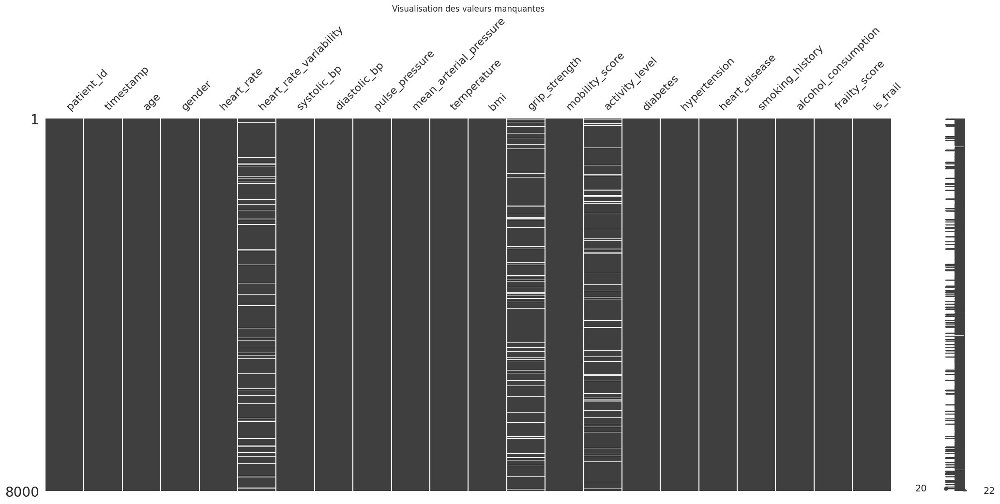

4️⃣ Distribution de la cible : age


5️⃣ Matrice de corrélation


6️⃣ Distributions des variables numériques


7️⃣ Distributions des variables catégoriques
⛔ Trop de modalités dans patient_id (8000 uniques)


8️⃣ Détection d’outliers


9️⃣ Cardinalité des variables catégoriques
🔹 patient_id: 8000 modalités
----------------------------------------
🔹 gender: 2 modalités
gender
F    0.555
M    0.445
Name: proportion, dtype: float64
----------------------------------------
✅ EDA terminée.

📌 Étape 2 : Analyse multivariée

🔍 Analyse Multivariée (PCA, t-SNE, UMAP)
➡️ Normalisation des données...
➡️ PCA...


➡️ t-SNE...


➡️ UMAP...


✅ Analyse multivariée terminée.

📌 Étape 3 : Interactions statistiques

📎 Analyse des interactions statistiques
➡️ ANOVA (numériques)


frailty_score             145.7361
mean_arterial_pressure     64.5200
systolic_bp                62.7341
is_frail                   57.8304
grip_strength              25.6148
pulse_pressure             19.9220
diastolic_bp               17.8214
diabetes                    1.4162
heart_disease               1.2586
heart_rate                  1.1930
dtype: float64

➡️ Chi² (catégoriques)


patient_id    43529.8590
gender           18.7538
dtype: float64

➡️ Mutual Information
⏩ Suppression des colonnes datetime pour MI: ['timestamp']


frailty_score             0.1851
mean_arterial_pressure    0.1044
systolic_bp               0.0967
grip_strength             0.0864
is_frail                  0.0614
diastolic_bp              0.0345
pulse_pressure            0.0274
heart_rate                0.0142
smoking_history           0.0140
hypertension              0.0085
dtype: float64

✅ Analyse des interactions terminée.

📌 Étape 4 : Feature Importance (LightGBM)

🌟 Feature Importance avec LightGBM
⏩ Transformation des colonnes datetime: ['timestamp']
➡️ Entraînement du modèle
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000888 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3407
[LightGBM] [Info] Number of data points in the train set: 6420, number of used features: 24
[LightGBM] [Info] Start training from score -2.017242
[LightGBM] [Info] Start training from score -3.608118
[LightGBM] [Info] Start training from score -3.369011
[LightGBM] [Info] Start training from score -3.274112
[LightGBM] [Info] Start training from score -3.303342
[LightGBM] [Info] Start training from score -3.143156
[LightGBM] [Info] Start training from score -3.125266
[LightGBM] [Info] Start training from score -3.053441
[LightGBM] [Info]

✅ Feature importance calculée.

📌 Étape 5 : Clustering

🔗 Clustering K-Means & DBSCAN
➡️ K-Means


➡️ DBSCAN


✅ Clustering terminé.

✅ Pipeline EDA terminée avec succès.


In [34]:
# Exemple simple
eda_pipeline(df, target="age")


🚀 Lancement de la pipeline EDA complète

📌 Étape 1 : EDA de base

📊 Démarrage de l’Analyse Exploratoire Avancée
1️⃣ Informations générales
➡️ Nombre d'observations: 8000
➡️ Nombre de variables: 22


float64           12
int64              7
object             2
datetime64[ns]     1
Name: count, dtype: int64

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8000 entries, 0 to 7999
Data columns (total 22 columns):
 #   Column                  Non-Null Count  Dtype         
---  ------                  --------------  -----         
 0   patient_id              8000 non-null   object        
 1   timestamp               8000 non-null   datetime64[ns]
 2   age                     8000 non-null   int64         
 3   gender                  8000 non-null   object        
 4   heart_rate              8000 non-null   float64       
 5   heart_rate_variability  7461 non-null   float64       
 6   systolic_bp             8000 non-null   float64       
 7   diastolic_bp            8000 non-null   float64       
 8   pulse_pressure          8000 non-null   float64       
 9   mean_arterial_pressure  8000 non-null   float64       
 10  temperature             8000 non-null   float64       
 11  bmi                     8000 non-null   float64       
 12  grip_strength           7402 non-null   float64 

None

2️⃣ Statistiques descriptives


,count,unique,top,freq,mean,min,25%,50%,75%,max,std
patient_id,8000,8000,P_00001,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
timestamp,8000,NaN,NaN,NaN,2024-06-15 15:29:59.999999744,2024-01-01 00:00:00,2024-03-24 07:45:00,2024-06-15 15:30:00,2024-09-06 23:15:00,2024-11-29 07:00:00,NaN
age,8000.0,NaN,NaN,NaN,74.9251,65.0,69.0,74.0,80.0,95.0,7.1995
gender,8000,2,F,4440,NaN,NaN,NaN,NaN,NaN,NaN,NaN
heart_rate,8000.0,NaN,NaN,NaN,72.1494,45.0,63.9183,72.1352,80.3311,120.0,11.8574
heart_rate_variability,7461.0,NaN,NaN,NaN,24.8255,5.0,7.1178,17.3701,34.2196,100.0,22.4814
systolic_bp,8000.0,NaN,NaN,NaN,129.7487,90.0,118.0288,129.6345,140.8698,192.2231,16.7244
diastolic_bp,8000.0,NaN,NaN,NaN,83.4384,50.0,76.6178,83.4916,90.3639,110.0,10.1617
pulse_pressure,8000.0,NaN,NaN,NaN,46.2434,-38.1142,33.6174,46.4075,58.8508,120.1843,18.6313
mean_arterial_pressure,8000.0,NaN,NaN,NaN,98.8642,62.8731,92.4746,98.8279,105.278,134.0034,9.3439


3️⃣ Valeurs manquantes


grip_strength             598
activity_level            563
heart_rate_variability    539
dtype: int64

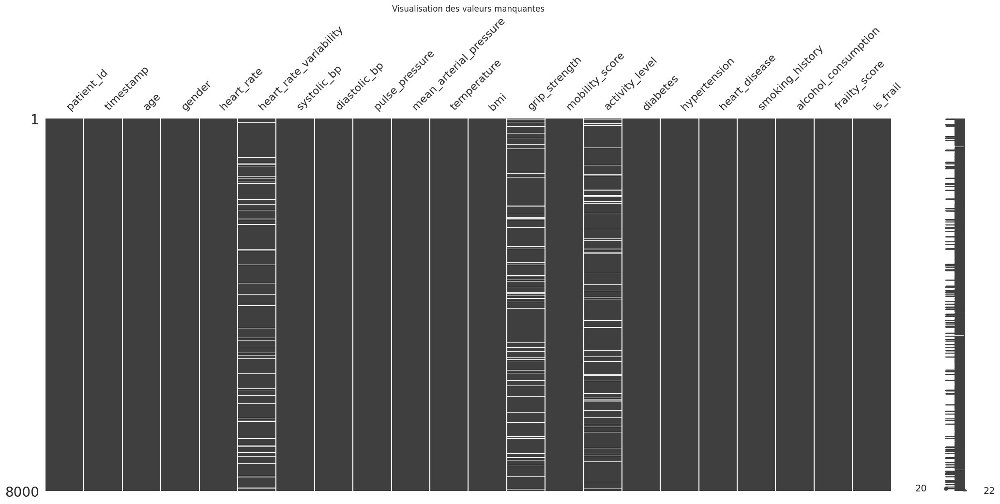

4️⃣ Distribution de la cible : age


5️⃣ Matrice de corrélation


6️⃣ Distributions des variables numériques


7️⃣ Distributions des variables catégoriques
⛔ Trop de modalités dans patient_id (8000 uniques)


8️⃣ Détection d’outliers


9️⃣ Cardinalité des variables catégoriques
🔹 patient_id: 8000 modalités
----------------------------------------
🔹 gender: 2 modalités
gender
F    0.555
M    0.445
Name: proportion, dtype: float64
----------------------------------------
✅ EDA terminée.

📌 Étape 2 : Analyse multivariée

🔍 Analyse Multivariée (PCA, t-SNE, UMAP)
➡️ Normalisation des données...
➡️ PCA...


➡️ t-SNE...


➡️ UMAP...


✅ Analyse multivariée terminée.

📌 Étape 4 : Feature Importance (LightGBM)

🌟 Feature Importance avec LightGBM
⏩ Transformation des colonnes datetime: ['timestamp']
➡️ Entraînement du modèle
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000679 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3407
[LightGBM] [Info] Number of data points in the train set: 6420, number of used features: 24
[LightGBM] [Info] Start training from score -2.017242
[LightGBM] [Info] Start training from score -3.608118
[LightGBM] [Info] Start training from score -3.369011
[LightGBM] [Info] Start training from score -3.274112
[LightGBM] [Info] Start training from score -3.303342
[LightGBM] [Info] Start training from score -3.143156
[LightGBM] [Info] Start training from score -3.125266
[LightGBM] [Info] Start training from score -3.053441
[LightGBM] [Info] Star

✅ Feature importance calculée.

✅ Pipeline EDA terminée avec succès.


In [35]:
# Exemple personnalisé
eda_pipeline(
    df,
    target="age",
    run_eda=True,
    run_multivariate=True,
    run_interactions=False,       # désactivé
    run_feature_importance=True,
    run_clustering=False
)


In [55]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import missingno as msno
import warnings

from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import umap.umap_ as umap
from sklearn.feature_selection import chi2, f_classif, mutual_info_classif
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.cluster import KMeans, DBSCAN
from lightgbm import LGBMClassifier

from IPython.display import display

warnings.filterwarnings("ignore")
sns.set(style="whitegrid")

class AdvancedEDA:
    def __init__(self, df: pd.DataFrame, target: str = None):
        self.df = df.copy()
        self.target = target
        self.df_numeric = self.df.select_dtypes(include=np.number).dropna()
        self.le = LabelEncoder()
        print("✅ Initialisation de l'objet AdvancedEDA")

    def eda_summary(self):
        print("\n📊 Analyse Exploratoire Initiale")
        print(f"➡️ Dimensions: {self.df.shape}")
        display(self.df.dtypes.value_counts())
        display(self.df.info())

        print("\n📌 Statistiques descriptives")
        display(self.df.describe(include='all').T)

        print("\n📌 Valeurs manquantes")
        missing = self.df.isnull().sum()
        missing = missing[missing > 0]
        if not missing.empty:
            display(missing)
            msno.matrix(self.df)
            plt.title("Visualisation des valeurs manquantes")
            plt.show()
        else:
            print("✅ Aucune valeur manquante")

        if self.target:
            print(f"\n🎯 Distribution de la cible : {self.target}")
            fig = px.pie(self.df, names=self.target, title="Distribution de la cible")
            fig.show()

        if len(self.df_numeric.columns) > 1:
            print("\n📌 Corrélation")
            corr = self.df_numeric.corr()
            fig = px.imshow(corr, text_auto=True, title="Matrice de Corrélation")
            fig.show()

    def plot_distributions(self):
        print("\n📈 Distributions des variables numériques")
        for col in self.df_numeric.columns:
            fig = px.histogram(self.df, x=col, color=self.target, marginal="box", nbins=30,
                               title=f"Distribution de {col}")
            fig.show()

        print("\n📊 Distributions des variables catégoriques")
        cat_cols = self.df.select_dtypes(include='object').columns
        for col in cat_cols:
            if self.df[col].nunique() < 50:
                fig = px.histogram(self.df, x=col, color=self.target,
                                   title=f"Distribution de {col}")
                fig.show()
    """
    def analyse_multivariee(self, n_components=2):
        print("\n🔍 Analyse Multivariée : PCA, t-SNE, UMAP")
        X = StandardScaler().fit_transform(self.df_numeric.drop(columns=[self.target], errors='ignore'))

        labels = self.df[self.target] if self.target else None

        print("➡️ PCA")
        X_pca = PCA(n_components=n_components).fit_transform(X)
        fig = px.scatter(x=X_pca[:, 0], y=X_pca[:, 1], color=labels, title="🎯 PCA")
        fig.show()

        print("➡️ t-SNE")
        X_tsne = TSNE(n_components=n_components, init='pca', learning_rate='auto').fit_transform(X)
        fig = px.scatter(x=X_tsne[:, 0], y=X_tsne[:, 1], color=labels, title="🌐 t-SNE")
        fig.show()

        print("➡️ UMAP")
        X_umap = umap.UMAP(n_components=n_components).fit_transform(X)
        fig = px.scatter(x=X_umap[:, 0], y=X_umap[:, 1], color=labels, title="🧬 UMAP")
        fig.show()
    """
    """
    def analyse_interactions(self):
        print("\n📎 Analyse des Interactions Statistiques")
        if self.df[self.target].dtype == 'object':
            self.df[self.target] = self.le.fit_transform(self.df[self.target])

        X = self.df.drop(columns=[self.target])
        y = self.df[self.target]

        print("➡️ ANOVA")
        f_scores, _ = f_classif(X.select_dtypes(include=np.number).fillna(0), y)
        display(pd.Series(f_scores, index=X.select_dtypes(include=np.number).columns)
                .sort_values(ascending=False).head(10))
      
        print("➡️ Chi²")
        cat_cols = X.select_dtypes(include='object').columns
        for col in cat_cols:
            X[col] = self.le.fit_transform(X[col].astype(str))
        
        # Maintenant cat_cols sont des colonnes int encodées
        chi_scores, _ = chi2(X[cat_cols], y)
        display(pd.Series(chi_scores, index=cat_cols).sort_values(ascending=False).head(10))

        print("➡️ Mutual Information")
        for col in X.select_dtypes(include='object'):
            X[col] = self.le.fit_transform(X[col].astype(str))
        mi = mutual_info_classif(X.fillna(0), y)
        display(pd.Series(mi, index=X.columns).sort_values(ascending=False).head(10))
        """
    def analyse_interactions(self):
        print("\n📎 Analyse des Interactions Statistiques")
    
        df = self.df.copy()
    
        if df[self.target].dtype == 'object':
            df[self.target] = self.le.fit_transform(df[self.target])
    
        X = df.drop(columns=[self.target])
        y = df[self.target]
    
        # Encodage des colonnes catégoriques en entier
        for col in X.select_dtypes(include='object'):
            X[col] = self.le.fit_transform(X[col].astype(str))
    
        # Transformer les colonnes datetime en features numériques dérivées
        datetime_cols = X.select_dtypes(include=['datetime64[ns]', 'datetime64']).columns
        for col in datetime_cols:
            X[col + '_timestamp'] = X[col].astype(np.int64)  # timestamp en nanosecondes
            X[col + '_year'] = X[col].dt.year
            X[col + '_month'] = X[col].dt.month
            X[col + '_day'] = X[col].dt.day
            X[col + '_weekday'] = X[col].dt.weekday
            # Optionnel: supprimer la colonne datetime d'origine
            X = X.drop(columns=[col])
    
        print("➡️ ANOVA")
        f_scores, _ = f_classif(X.select_dtypes(include=np.number).fillna(0), y)
        display(pd.Series(f_scores, index=X.select_dtypes(include=np.number).columns)
                .sort_values(ascending=False).head(10))
    
        print("➡️ Chi²")
        cat_cols = X.select_dtypes(include='int').columns
        if len(cat_cols) > 0:
            chi_scores, _ = chi2(X[cat_cols].fillna(0), y)
            display(pd.Series(chi_scores, index=cat_cols)
                    .sort_values(ascending=False).head(10))
        else:
            print("❌ Pas de colonnes catégoriques pour Chi²")
    
        print("➡️ Mutual Information")
        mi = mutual_info_classif(X.fillna(0), y)
        display(pd.Series(mi, index=X.columns).sort_values(ascending=False).head(10))

        """   
    def analyse_multivariee(self, n_components=2):
        print("\n🔍 Analyse Multivariée : PCA, t-SNE, UMAP")
    
        # Supprimer les lignes avec NaN dans target ou dans les colonnes numériques (utilisées pour la PCA)
        df_clean = self.df.dropna(subset=[self.target] + list(self.df_numeric.columns))
        
        X = StandardScaler().fit_transform(df_clean.drop(columns=[self.target], errors='ignore'))
        labels = df_clean[self.target] if self.target else None
    
        print("➡️ PCA")
        X_pca = PCA(n_components=n_components).fit_transform(X)
        fig = px.scatter(x=X_pca[:, 0], y=X_pca[:, 1], color=labels, title="🎯 PCA")
        fig.show()
    
        print("➡️ t-SNE")
        X_tsne = TSNE(n_components=n_components, init='pca', learning_rate='auto').fit_transform(X)
        fig = px.scatter(x=X_tsne[:, 0], y=X_tsne[:, 1], color=labels, title="🌐 t-SNE")
        fig.show()
    
        print("➡️ UMAP")
        X_umap = umap.UMAP(n_components=n_components).fit_transform(X)
        fig = px.scatter(x=X_umap[:, 0], y=X_umap[:, 1], color=labels, title="🧬 UMAP")
        fig.show()
     """
        """
    def analyse_multivariee(self, n_components=2):
        print("\n🔍 Analyse Multivariée : PCA, t-SNE, UMAP")
    
        # Nettoyer les lignes avec NaN dans target ou variables numériques
        df_clean = self.df.dropna(subset=[self.target] + list(self.df_numeric.columns))
        
        # Extraire X
        X = df_clean.drop(columns=[self.target], errors='ignore').copy()
        
        # Encoder les colonnes object / catégories en entiers
        for col in X.select_dtypes(include=['object', 'category']).columns:
            X[col] = pd.factorize(X[col])[0]
        
        # Maintenant standardiser
        X_scaled = StandardScaler().fit_transform(X)
    
        labels = df_clean[self.target] if self.target else None
    
        print("➡️ PCA")
        X_pca = PCA(n_components=n_components).fit_transform(X_scaled)
        fig = px.scatter(x=X_pca[:, 0], y=X_pca[:, 1], color=labels, title="🎯 PCA")
        fig.show()
    
        print("➡️ t-SNE")
        X_tsne = TSNE(n_components=n_components, init='pca', learning_rate='auto').fit_transform(X_scaled)
        fig = px.scatter(x=X_tsne[:, 0], y=X_tsne[:, 1], color=labels, title="🌐 t-SNE")
        fig.show()
    
        print("➡️ UMAP")
        X_umap = umap.UMAP(n_components=n_components).fit_transform(X_scaled)
        fig = px.scatter(x=X_umap[:, 0], y=X_umap[:, 1], color=labels, title="🧬 UMAP")
        fig.show()
     """
    def analyse_multivariee(self, n_components=2):
        print("\n🔍 Analyse Multivariée : PCA, t-SNE, UMAP")
    
        # Nettoyer les lignes avec NaN dans target ou variables numériques
        #df_clean = self.df.dropna(subset=[self.target] + list(self.df_numeric.columns))
        numeric_cols = self.df.select_dtypes(include=np.number).columns.tolist()
        df_clean = self.df.dropna(subset=[self.target] + numeric_cols)

    
        # Extraire X
        X = df_clean.drop(columns=[self.target], errors='ignore').copy()
    
        # Convertir les datetime en timestamp (nombre entier)
        for col in X.select_dtypes(include=['datetime64[ns]', 'datetime64']).columns:
            X[col] = X[col].astype(np.int64)  # nombre de nanosecondes depuis epoch
    
        # Encoder les colonnes catégoriques en entiers
        for col in X.select_dtypes(include=['object', 'category']).columns:
            X[col] = pd.factorize(X[col])[0]
    
        # Maintenant standardiser
        X_scaled = StandardScaler().fit_transform(X)
    
        labels = df_clean[self.target] if self.target else None
    
        print("➡️ PCA")
        X_pca = PCA(n_components=n_components).fit_transform(X_scaled)
        fig = px.scatter(x=X_pca[:, 0], y=X_pca[:, 1], color=labels, title="🎯 PCA")
        fig.show()
    
        print("➡️ t-SNE")
        X_tsne = TSNE(n_components=n_components, init='pca', learning_rate='auto').fit_transform(X_scaled)
        fig = px.scatter(x=X_tsne[:, 0], y=X_tsne[:, 1], color=labels, title="🌐 t-SNE")
        fig.show()
    
        print("➡️ UMAP")
        X_umap = umap.UMAP(n_components=n_components).fit_transform(X_scaled)
        fig = px.scatter(x=X_umap[:, 0], y=X_umap[:, 1], color=labels, title="🧬 UMAP")
        fig.show()

    """
    def feature_importance(self):
        print("\n🌟 Feature Importance avec LightGBM")
        df = self.df.dropna()
        for col in df.select_dtypes(include='object'):
            df[col] = self.le.fit_transform(df[col].astype(str))

        X = df.drop(columns=[self.target])
        y = df[self.target]

        model = LGBMClassifier()
        model.fit(X, y)
        importances = pd.Series(model.feature_importances_, index=X.columns).sort_values(ascending=False)

        fig = px.bar(importances.head(20), orientation='h', title="🔝 Top Features (LightGBM)")
        fig.show()
    """
    def feature_importance(self):
        print("\n🌟 Feature Importance avec LightGBM")
        df = self.df.dropna().copy()
    
        for col in df.select_dtypes(include='object'):
            df[col] = self.le.fit_transform(df[col].astype(str))
    
        # Transformer les colonnes datetime en int64 timestamp
        datetime_cols = df.select_dtypes(include=['datetime64[ns]', 'datetime64']).columns
        for col in datetime_cols:
            df[col] = df[col].astype(np.int64)
    
        X = df.drop(columns=[self.target])
        y = df[self.target]
    
        model = LGBMClassifier()
        model.fit(X, y)
        importances = pd.Series(model.feature_importances_, index=X.columns).sort_values(ascending=False)
    
        fig = px.bar(importances.head(20), orientation='h', title="🔝 Top Features (LightGBM)")
        fig.show()


    def clustering(self, n_clusters=3):
        print("\n🔗 Clustering : KMeans & DBSCAN")
        X = StandardScaler().fit_transform(self.df_numeric)

        print("➡️ KMeans")
        kmeans = KMeans(n_clusters=n_clusters, random_state=42)
        self.df_numeric["kmeans_cluster"] = kmeans.fit_predict(X)
        fig = px.scatter_matrix(self.df_numeric, dimensions=self.df_numeric.columns[:-1],
                                color='kmeans_cluster', title="Clusters (KMeans)")
        fig.show()

        print("➡️ DBSCAN")
        dbscan = DBSCAN(eps=2.0, min_samples=5)
        self.df_numeric["dbscan_cluster"] = dbscan.fit_predict(X)
        fig = px.scatter_matrix(self.df_numeric, dimensions=self.df_numeric.columns[:-2],
                                color='dbscan_cluster', title="Clusters (DBSCAN)")
        fig.show()

    def run(self, steps: list = None):
        """
        🚀 Exécute une pipeline complète ou partielle.
        Paramètre steps : liste des étapes à exécuter, ex : ['eda', 'multi', 'importance']
        """
        all_steps = {
            'eda': self.eda_summary,
            'distributions': self.plot_distributions,
            'multi': self.analyse_multivariee,
            'interactions': self.analyse_interactions,
            'importance': self.feature_importance,
            'clustering': self.clustering
        }

        if steps is None:
            steps = list(all_steps.keys())

        print(f"\n📦 Lancement des étapes : {steps}")

        for step in steps:
            if step in all_steps:
                all_steps[step]()
            else:
                print(f"❌ Étape inconnue : {step}")

        print("\n✅ Pipeline EDA OOP terminée.")


✅ Initialisation de l'objet AdvancedEDA

📦 Lancement des étapes : ['eda', 'distributions', 'multi', 'interactions', 'importance', 'clustering']

📊 Analyse Exploratoire Initiale
➡️ Dimensions: (8000, 22)


float64           12
int64              7
object             2
datetime64[ns]     1
Name: count, dtype: int64

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8000 entries, 0 to 7999
Data columns (total 22 columns):
 #   Column                  Non-Null Count  Dtype         
---  ------                  --------------  -----         
 0   patient_id              8000 non-null   object        
 1   timestamp               8000 non-null   datetime64[ns]
 2   age                     8000 non-null   int64         
 3   gender                  8000 non-null   object        
 4   heart_rate              8000 non-null   float64       
 5   heart_rate_variability  7461 non-null   float64       
 6   systolic_bp             8000 non-null   float64       
 7   diastolic_bp            8000 non-null   float64       
 8   pulse_pressure          8000 non-null   float64       
 9   mean_arterial_pressure  8000 non-null   float64       
 10  temperature             8000 non-null   float64       
 11  bmi                     8000 non-null   float64       
 12  grip_strength           7402 non-null   float64 

None


📌 Statistiques descriptives


,count,unique,top,freq,mean,min,25%,50%,75%,max,std
patient_id,8000,8000,P_00001,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
timestamp,8000,NaN,NaN,NaN,2024-06-15 15:29:59.999999744,2024-01-01 00:00:00,2024-03-24 07:45:00,2024-06-15 15:30:00,2024-09-06 23:15:00,2024-11-29 07:00:00,NaN
age,8000.0,NaN,NaN,NaN,74.9251,65.0,69.0,74.0,80.0,95.0,7.1995
gender,8000,2,F,4440,NaN,NaN,NaN,NaN,NaN,NaN,NaN
heart_rate,8000.0,NaN,NaN,NaN,72.1494,45.0,63.9183,72.1352,80.3311,120.0,11.8574
heart_rate_variability,7461.0,NaN,NaN,NaN,24.8255,5.0,7.1178,17.3701,34.2196,100.0,22.4814
systolic_bp,8000.0,NaN,NaN,NaN,129.7487,90.0,118.0288,129.6345,140.8698,192.2231,16.7244
diastolic_bp,8000.0,NaN,NaN,NaN,83.4384,50.0,76.6178,83.4916,90.3639,110.0,10.1617
pulse_pressure,8000.0,NaN,NaN,NaN,46.2434,-38.1142,33.6174,46.4075,58.8508,120.1843,18.6313
mean_arterial_pressure,8000.0,NaN,NaN,NaN,98.8642,62.8731,92.4746,98.8279,105.278,134.0034,9.3439



📌 Valeurs manquantes


heart_rate_variability    539
grip_strength             598
activity_level            563
dtype: int64

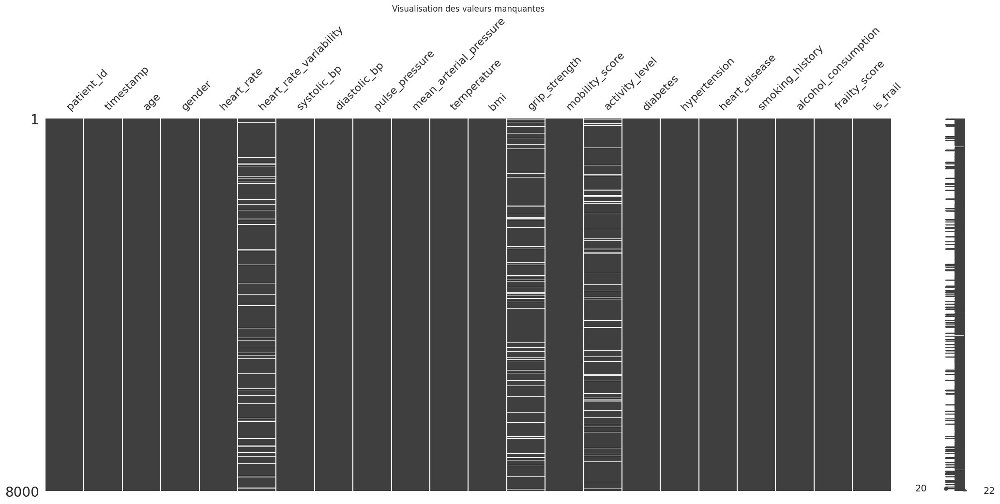


🎯 Distribution de la cible : gender



📌 Corrélation



📈 Distributions des variables numériques



📊 Distributions des variables catégoriques



🔍 Analyse Multivariée : PCA, t-SNE, UMAP
➡️ PCA


➡️ t-SNE


➡️ UMAP



📎 Analyse des Interactions Statistiques
➡️ ANOVA


heart_rate_variability    5.2076
timestamp_month           3.0547
patient_id                2.6423
timestamp_timestamp       2.6423
heart_disease             2.0748
timestamp_day             1.8265
timestamp_weekday         1.7218
pulse_pressure            0.9686
bmi                       0.8549
diastolic_bp              0.8165
dtype: float64

➡️ Chi²


timestamp_timestamp    1.0627e+14
patient_id             3.5232e+03
timestamp_day          8.9596e+00
timestamp_month        5.0529e+00
timestamp_weekday      2.3036e+00
heart_disease          1.6487e+00
is_frail               5.2962e-01
smoking_history        4.0379e-01
diabetes               2.4152e-01
age                    8.8476e-02
dtype: float64

➡️ Mutual Information


activity_level            0.0078
timestamp_weekday         0.0077
hypertension              0.0065
diabetes                  0.0028
smoking_history           0.0027
mean_arterial_pressure    0.0012
grip_strength             0.0006
mobility_score            0.0004
age                       0.0002
timestamp_day             0.0000
dtype: float64


🌟 Feature Importance avec LightGBM
[LightGBM] [Info] Number of positive: 2845, number of negative: 3575
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000691 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3617
[LightGBM] [Info] Number of data points in the train set: 6420, number of used features: 21
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.443146 -> initscore=-0.228402
[LightGBM] [Info] Start training from score -0.228402



🔗 Clustering : KMeans & DBSCAN
➡️ KMeans


➡️ DBSCAN



✅ Pipeline EDA OOP terminée.

📦 Lancement des étapes : ['multi', 'importance']

🔍 Analyse Multivariée : PCA, t-SNE, UMAP
➡️ PCA


➡️ t-SNE


➡️ UMAP



🌟 Feature Importance avec LightGBM
[LightGBM] [Info] Number of positive: 2845, number of negative: 3575
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001034 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3617
[LightGBM] [Info] Number of data points in the train set: 6420, number of used features: 21
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.443146 -> initscore=-0.228402
[LightGBM] [Info] Start training from score -0.228402



✅ Pipeline EDA OOP terminée.


In [56]:
#from advanced_eda import AdvancedEDA

# Chargement des données
#df = sns.load_dataset("titanic")
target = "frailty_score"

# Création de l’objet
eda = AdvancedEDA(df, target)

# Lancer toutes les étapes
eda.run()

# Ou lancer seulement PCA + feature importance
eda.run(steps=['multi', 'importance'])


2025/06/21 13:48:28 INFO mlflow.tracking.fluent: Experiment with name 'Frailty_LGBM' does not exist. Creating a new experiment.


📥 Génération du dataset de fragilité
✅ 8000 lignes, 22 colonnes
🎯 Cible : {0: 7424, 1: 576}
🧪 Initialisation MLflow
🏁 Lancement du run MLflow
[LightGBM] [Info] Number of positive: 358, number of negative: 4778
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000546 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2852
[LightGBM] [Info] Number of data points in the train set: 5136, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.069704 -> initscore=-2.591244
[LightGBM] [Info] Start training from score -2.591244
🎯 Accuracy: 0.949, Precision: 0.745, Recall: 0.446
✅ Run terminé. Artefacts prêts.

📁 Fichiers générés dans mlruns:
ls: cannot access '/kaggle/working/mlruns/0/*/*': No such file or directory


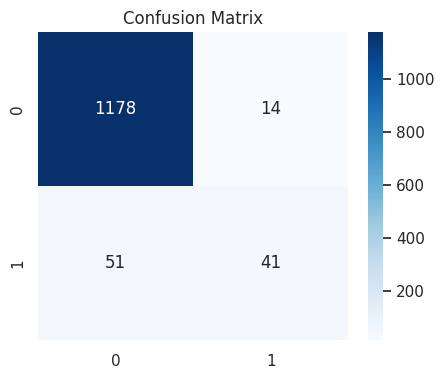

In [58]:
# ==============================================================================
# 📦 Environnement
# ==============================================================================
import pandas as pd
import numpy as np
import mlflow
import mlflow.sklearn
import matplotlib.pyplot as plt
#import seababorn as sns
import seaborn as sns
import os
import joblib

from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, precision_score, recall_score, confusion_matrix
from lightgbm import LGBMClassifier

sns.set(style="whitegrid")

# ==============================================================================
# 🏗 Génération de données de fragilité
# ==============================================================================
def generate_synthetic_frailty_data(n_samples: int = 5000) -> pd.DataFrame:
    np.random.seed(42)
    patient_ids = [f"P_{i:05d}" for i in range(1, n_samples + 1)]
    ages = np.random.normal(75, 8, n_samples).clip(65, 95).astype(int)
    genders = np.random.choice(['M', 'F'], n_samples, p=[0.45, 0.55])
    base_heart_rate = np.random.normal(72, 12, n_samples)
    heart_rate_variability = np.random.exponential(25, n_samples)
    age_factor = (ages - 65) / 30
    systolic_bp = 120 + age_factor * 30 + np.random.normal(0, 15, n_samples)
    diastolic_bp = 80 + age_factor * 10 + np.random.normal(0, 10, n_samples)
    temperature = np.random.normal(36.6, 0.4, n_samples).clip(35.5, 38.5)
    activity_base = np.random.gamma(2, 2, n_samples)
    mobility_score = np.random.beta(2, 3, n_samples) * 10
    bmi = np.random.normal(26, 4, n_samples).clip(18, 40)
    grip_strength = 35 - (ages - 65) * 0.5 + np.random.normal(0, 8, n_samples)
    grip_strength = grip_strength.clip(10, 50)
    diabetes = np.random.binomial(1, 0.25, n_samples)
    hypertension = np.random.binomial(1, 0.4, n_samples)
    heart_disease = np.random.binomial(1, 0.2, n_samples)
    smoking_history = np.random.choice([0, 1, 2], n_samples, p=[0.6, 0.3, 0.1])
    alcohol_consumption = np.random.choice([0, 1, 2, 3], n_samples, p=[0.3, 0.4, 0.2, 0.1])
    timestamps = pd.to_datetime(pd.date_range('2024-01-01', periods=n_samples, freq='H'))
    pulse_pressure = systolic_bp - diastolic_bp
    mean_arterial_pressure = diastolic_bp + pulse_pressure / 3
    frailty_score = (
        0.3 * (ages > 80).astype(int) +
        0.2 * (grip_strength < 20).astype(int) +
        0.2 * (mobility_score < 3).astype(int) +
        0.1 * (bmi < 20).astype(int) +
        0.1 * diabetes +
        0.1 * heart_disease +
        np.random.normal(0, 0.15, n_samples)
    )
    is_frail = (frailty_score > 0.6).astype(int)
    data = pd.DataFrame({
        'patient_id': patient_ids, 'timestamp': timestamps, 'age': ages, 'gender': genders,
        'heart_rate': base_heart_rate.clip(45, 120), 'heart_rate_variability': heart_rate_variability.clip(5, 100),
        'systolic_bp': systolic_bp.clip(90, 200), 'diastolic_bp': diastolic_bp.clip(50, 110),
        'pulse_pressure': pulse_pressure, 'mean_arterial_pressure': mean_arterial_pressure,
        'temperature': temperature, 'bmi': bmi, 'grip_strength': grip_strength, 'mobility_score': mobility_score,
        'activity_level': activity_base.clip(0, 10), 'diabetes': diabetes, 'hypertension': hypertension,
        'heart_disease': heart_disease, 'smoking_history': smoking_history, 'alcohol_consumption': alcohol_consumption,
        'frailty_score': frailty_score.clip(0, 1), 'is_frail': is_frail
    })
    for col in ['heart_rate_variability', 'grip_strength', 'activity_level']:
        data.loc[np.random.rand(n_samples) < 0.07, col] = np.nan
    return data

# ==============================================================================
# 📥 Chargement des données
# ==============================================================================
print("📥 Génération du dataset de fragilité")
df = generate_synthetic_frailty_data(8000)
print(f"✅ {df.shape[0]} lignes, {df.shape[1]} colonnes")
print(f"🎯 Cible : {df['is_frail'].value_counts().to_dict()}")

# Prétraitement
df = df.drop(columns=["patient_id", "timestamp", "frailty_score"])
df["gender"] = df["gender"].map({"M": 0, "F": 1})
df = df.dropna()

X = df.drop(columns="is_frail")
y = df["is_frail"]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# ==============================================================================
# 🚀 MLflow (local)
# ==============================================================================
print("🧪 Initialisation MLflow")
mlflow.set_tracking_uri("file:/kaggle/working/mlruns")
mlflow.set_experiment("Frailty_LGBM")

# ==============================================================================
# ✅ Entraînement + Tracking
# ==============================================================================
print("🏁 Lancement du run MLflow")

with mlflow.start_run():
    params = {"n_estimators": 100, "learning_rate": 0.1, "random_state": 42}
    model = LGBMClassifier(**params)
    model.fit(X_train, y_train)

    y_pred = model.predict(X_test)
    acc = accuracy_score(y_test, y_pred)
    prec = precision_score(y_test, y_pred)
    rec = recall_score(y_test, y_pred)

    print(f"🎯 Accuracy: {acc:.3f}, Precision: {prec:.3f}, Recall: {rec:.3f}")

    mlflow.log_params(params)
    mlflow.log_metrics({"accuracy": acc, "precision": prec, "recall": rec})

    with open("note.txt", "w") as f:
        f.write(f"Model Accuracy: {acc:.3f}")
    mlflow.log_artifact("note.txt")

    # Confusion Matrix
    cm = confusion_matrix(y_test, y_pred)
    plt.figure(figsize=(5, 4))
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues")
    plt.title("Confusion Matrix")
    plt.savefig("confusion_matrix.png")
    mlflow.log_artifact("confusion_matrix.png")

    # Save Model
    joblib.dump(model, "model_lgbm.pkl")
    mlflow.log_artifact("model_lgbm.pkl")

print("✅ Run terminé. Artefacts prêts.")

# ==============================================================================
# 📂 Exploration des artefacts
# ==============================================================================
print("\n📁 Fichiers générés dans mlruns:")
!ls /kaggle/working/mlruns/0/*/*



📥 Génération du dataset de fragilité
✅ 8000 lignes, 22 colonnes
🎯 Cible : {0: 7424, 1: 576}
🧪 Initialisation MLflow
🏁 Lancement du run MLflow
[LightGBM] [Info] Number of positive: 358, number of negative: 4778
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000481 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2852
[LightGBM] [Info] Number of data points in the train set: 5136, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.069704 -> initscore=-2.591244
[LightGBM] [Info] Start training from score -2.591244
🎯 Accuracy: 0.949, Precision: 0.745, Recall: 0.446
✅ Run terminé. Artefacts prêts.
📁 Fichiers générés dans mlruns:
/kaggle/working/mlruns/854865051169262959/meta.yaml
/kaggle/working/mlruns/854865051169262959/0edd9b2b58ad477482353ef0e77edfb2/meta.yaml
/kaggle/working/mlruns/854865051169262959/0edd9b2

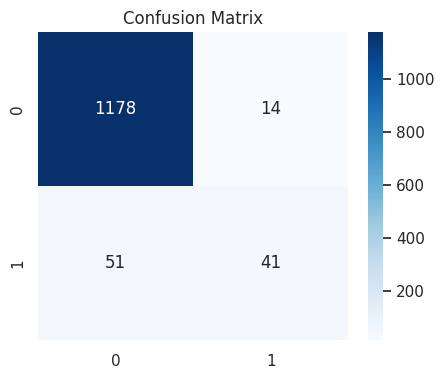

In [59]:
# ==============================================================================
# 📦 Environnement
# ==============================================================================
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import mlflow
import mlflow.sklearn
import joblib
import os

from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, precision_score, recall_score, confusion_matrix
from lightgbm import LGBMClassifier

sns.set(style="whitegrid")

RANDOM_STATE = 42

# ==============================================================================
# 📊 Génération de données synthétiques de fragilité
# ==============================================================================

def generate_synthetic_frailty_data(n_samples: int = 5000) -> pd.DataFrame:
    np.random.seed(RANDOM_STATE)
    
    patient_ids = [f"P_{i:05d}" for i in range(1, n_samples + 1)]
    ages = np.random.normal(75, 8, n_samples).clip(65, 95).astype(int)
    genders = np.random.choice(['M', 'F'], n_samples, p=[0.45, 0.55])
    
    base_heart_rate = np.random.normal(72, 12, n_samples)
    heart_rate_variability = np.random.exponential(25, n_samples)
    
    age_factor = (ages - 65) / 30
    systolic_bp = 120 + age_factor * 30 + np.random.normal(0, 15, n_samples)
    diastolic_bp = 80 + age_factor * 10 + np.random.normal(0, 10, n_samples)
    
    temperature = np.random.normal(36.6, 0.4, n_samples).clip(35.5, 38.5)
    activity_base = np.random.gamma(2, 2, n_samples)
    mobility_score = np.random.beta(2, 3, n_samples) * 10
    bmi = np.random.normal(26, 4, n_samples).clip(18, 40)
    grip_strength = 35 - (ages - 65) * 0.5 + np.random.normal(0, 8, n_samples)
    grip_strength = grip_strength.clip(10, 50)
    
    diabetes = np.random.binomial(1, 0.25, n_samples)
    hypertension = np.random.binomial(1, 0.4, n_samples)
    heart_disease = np.random.binomial(1, 0.2, n_samples)
    
    smoking_history = np.random.choice([0, 1, 2], n_samples, p=[0.6, 0.3, 0.1])
    alcohol_consumption = np.random.choice([0, 1, 2, 3], n_samples, p=[0.3, 0.4, 0.2, 0.1])
    
    timestamps = pd.to_datetime(pd.date_range('2024-01-01', periods=n_samples, freq='H'))
    pulse_pressure = systolic_bp - diastolic_bp
    mean_arterial_pressure = diastolic_bp + pulse_pressure / 3
    
    frailty_score = (
        0.3 * (ages > 80).astype(int) +
        0.2 * (grip_strength < 20).astype(int) +
        0.2 * (mobility_score < 3).astype(int) +
        0.1 * (bmi < 20).astype(int) +
        0.1 * diabetes +
        0.1 * heart_disease +
        np.random.normal(0, 0.15, n_samples)
    )
    is_frail = (frailty_score > 0.6).astype(int)
    
    data = pd.DataFrame({
        'patient_id': patient_ids, 'timestamp': timestamps, 'age': ages, 'gender': genders,
        'heart_rate': base_heart_rate.clip(45, 120), 'heart_rate_variability': heart_rate_variability.clip(5, 100),
        'systolic_bp': systolic_bp.clip(90, 200), 'diastolic_bp': diastolic_bp.clip(50, 110),
        'pulse_pressure': pulse_pressure, 'mean_arterial_pressure': mean_arterial_pressure,
        'temperature': temperature, 'bmi': bmi, 'grip_strength': grip_strength, 'mobility_score': mobility_score,
        'activity_level': activity_base.clip(0, 10), 'diabetes': diabetes, 'hypertension': hypertension,
        'heart_disease': heart_disease, 'smoking_history': smoking_history, 'alcohol_consumption': alcohol_consumption,
        'frailty_score': frailty_score.clip(0, 1), 'is_frail': is_frail
    })
    
    # Simuler des valeurs manquantes
    missing_cols = ['heart_rate_variability', 'grip_strength', 'activity_level']
    for col in missing_cols:
        missing_mask = np.random.random(n_samples) < 0.07
        data.loc[missing_mask, col] = np.nan
    
    return data

# ==============================================================================
# 📥 Données
# ==============================================================================
print("📥 Génération du dataset de fragilité")
df = generate_synthetic_frailty_data(n_samples=8000)
print(f"✅ {df.shape[0]} lignes, {df.shape[1]} colonnes")
print(f"🎯 Cible : {df['is_frail'].value_counts().to_dict()}")

# Encodage des variables catégoriques
df["gender"] = df["gender"].map({"M": 0, "F": 1})

# Sélection des features utiles pour le modèle
features = [
    'age', 'gender', 'heart_rate', 'heart_rate_variability',
    'systolic_bp', 'diastolic_bp', 'pulse_pressure', 'mean_arterial_pressure',
    'temperature', 'bmi', 'grip_strength', 'mobility_score', 'activity_level',
    'diabetes', 'hypertension', 'heart_disease', 'smoking_history', 'alcohol_consumption'
]

df_model = df.dropna(subset=features + ['is_frail'])

X = df_model[features]
y = df_model["is_frail"]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=RANDOM_STATE)

# ==============================================================================
# 🚀 MLflow Tracking
# ==============================================================================
print("🧪 Initialisation MLflow")
mlflow.set_tracking_uri("file:/kaggle/working/mlruns")
mlflow.set_experiment("Frailty_LGBM")

print("🏁 Lancement du run MLflow")

with mlflow.start_run():
    params = {
        "n_estimators": 100,
        "learning_rate": 0.1,
        "random_state": RANDOM_STATE
    }

    model = LGBMClassifier(**params)
    model.fit(X_train, y_train)

    y_pred = model.predict(X_test)

    acc = accuracy_score(y_test, y_pred)
    prec = precision_score(y_test, y_pred)
    rec = recall_score(y_test, y_pred)

    print(f"🎯 Accuracy: {acc:.3f}, Precision: {prec:.3f}, Recall: {rec:.3f}")

    mlflow.log_params(params)
    mlflow.log_metrics({
        "accuracy": acc,
        "precision": prec,
        "recall": rec
    })

    # Sauvegarde note
    with open("note.txt", "w") as f:
        f.write(f"Modèle LGBM - Accuracy: {acc:.3f}, Precision: {prec:.3f}, Recall: {rec:.3f}")
    mlflow.log_artifact("note.txt")

    # Confusion matrix
    cm = confusion_matrix(y_test, y_pred)
    plt.figure(figsize=(5, 4))
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues")
    plt.title("Confusion Matrix")
    plt.savefig("confusion_matrix.png")
    mlflow.log_artifact("confusion_matrix.png")

    # Modèle
    joblib.dump(model, "model_lgbm.pkl")
    mlflow.log_artifact("model_lgbm.pkl")

print("✅ Run terminé. Artefacts prêts.")

# ==============================================================================
# 🔍 Exploration des artefacts sauvegardés
# ==============================================================================
print("📁 Fichiers générés dans mlruns:")
for root, dirs, files in os.walk("/kaggle/working/mlruns"):
    for name in files:
        print(os.path.join(root, name))
